# Veress Needle Classification

## Analyze cross-testing

Justin Reynolds

In [1]:
import numpy as np
import pandas as pd
import pickle
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import os, sys, time
import seaborn as sn
print("Analyze veress classification cross-testing results (v20210817)\n")
input_path="/home/jreynolds/21summer/veress/classification/data/v20210817/CT_results/"
results_path="/Users/justinreynolds/Desktop/21summer/veress/classification/results/v20210817/"
dirs = os.listdir(input_path)
vid_list=[1, 2, 3, 4, 5, 6, 7, 8]
labels_map={0: 'fat', 1: 'muscle', 2: 'abdominal space', 3: 'intestine'}
class_names=['fat', 'muscle', 'abdominal space', 'intestine']
arch_dict={0: 'ResNet50', 1: 'InceptionV3', 2: 'Xception'}
print("Path to root of input files: %s"%str(input_path))

Analyze veress classification cross-testing results (v20210817)

Path to root of input files: /home/jreynolds/21summer/veress/classification/data/v20210817/CT_results/


# Input data
> **y_eval**:     a tuple in the form of (y_predtest_loss, y_predtest_acc)<br>
> **interptime**: time to predict a single image<br>
> **traintime**:  time to train the test model<br>
> **X_test**:     array of images used for testing<br>
> **y_test**:     array of labels used for testing<br>
> **trainhist**:  training history of the testing model<br>

In [2]:
y_eval_dict, y_preds_dict, interptime_dict, traintime_dict, X_test_dict, y_test_dict, trainhist_dict = {}, {}, {}, {}, {}, {}, {}

ld=[]
count=0
# y_evals
t1=time.time()
for vid in vid_list:
    with open(input_path+'ct_S'+str(vid)+'_y_eval.npy', 'rb') as f:
        y_eval=np.load(f)
    y_eval_dict[vid]=y_eval
ld.append(time.time()-t1)
print("y_evals:     %.2f secs"%ld[count])
count+=1
# y_preds
t1=time.time()
for vid in vid_list:
    with open(input_path+'ct_S'+str(vid)+'_y_preds.npy', 'rb') as f:
        y_preds=np.load(f)
    y_preds_dict[vid]=y_preds
ld.append(time.time()-t1)
print("y_preds:     %.2f secs"%ld[count])
count+=1
# interptime
t1=time.time()
for vid in vid_list:
    with open(input_path+'ct_S'+str(vid)+'_interptime.npy', 'rb') as f:
        interptime=np.load(f)
    interptime_dict[vid]=interptime
ld.append(time.time()-t1)
print("interptimes: %.2f secs"%ld[count])
count+=1
# traintime
t1=time.time()
for vid in vid_list:
    with open(input_path+'ct_S'+str(vid)+'_traintime.npy', 'rb') as f:
        traintime=np.load(f)
    traintime_dict[vid]=traintime
ld.append(time.time()-t1)
print("traintimes:  %.2f secs"%ld[count])
count+=1
# y_test
t1=time.time()
for vid in vid_list:
    with open(input_path+'ct_S'+str(vid)+'_y_test.npy', 'rb') as f:
        y_test=np.load(f)
    y_test_dict[vid]=y_test
ld.append(time.time()-t1)
print("y_tests:     %.2f secs"%ld[count])
count+=1
# trainhist
t1=time.time()
for vid in vid_list:
    with open(input_path+'ct_S'+str(vid)+'_trainhist.pickle', 'rb') as p:
        trainhist=pickle.load(p)
    df_hist=pd.DataFrame(trainhist)
    trainhist_dict[vid]=df_hist
ld.append(time.time()-t1)
print("trainhists:  %.2f secs"%ld[count])
count+=1
# X_test
t1=time.time()
for vid in vid_list:
    with open(input_path+'ct_S'+str(vid)+'_X_test.npy', 'rb') as f:
        X_test=np.load(f)
    X_test_dict[vid]=X_test
ld.append(time.time()-t1)
print("X_tests:     %.2f secs"%ld[count])
count+=1
# datamat
t1=time.time()
with open(input_path+'S1_alldata.pickle', 'rb') as p:
    data_mat=pickle.load(p)
ld.append(time.time()-t1)
print("datamat:     %.2f secs"%ld[count])
count+=1
print("\nTotal input time: %.2f secs"%sum(ld))

y_evals:     0.00 secs
y_preds:     0.00 secs
interptimes: 0.00 secs
traintimes:  0.00 secs
y_tests:     0.00 secs
trainhists:  0.00 secs
X_tests:     1.22 secs
datamat:     2.47 secs

Total input time: 3.70 secs


## Get winners and their stats

In [3]:
winners_dict={}
for vid in vid_list:
    for arch in arch_dict:
        dirname_winner = 'ct_Model_S'+str(vid)+'_'+str(arch_dict[arch])
        if os.path.isdir(input_path+dirname_winner):
            winners_dict[vid]=arch_dict[arch]
            print('\nS%d winner:           %s'%(vid, arch_dict[arch]))
            print("train_time:          %.3f secs"%traintime_dict[vid])
            print("interp_time_per_img: %f secs"%interptime_dict[vid][1])
            print("test_accuracy:       %f"%y_eval_dict[vid][1])


S1 winner:           Xception
train_time:          5894.278 secs
interp_time_per_img: 0.001765 secs
test_accuracy:       0.979500

S2 winner:           Xception
train_time:          5842.703 secs
interp_time_per_img: 0.001743 secs
test_accuracy:       0.931000

S3 winner:           Xception
train_time:          5844.400 secs
interp_time_per_img: 0.001738 secs
test_accuracy:       0.972000

S4 winner:           InceptionV3
train_time:          1905.599 secs
interp_time_per_img: 0.001262 secs
test_accuracy:       0.979750

S5 winner:           Xception
train_time:          5859.507 secs
interp_time_per_img: 0.001758 secs
test_accuracy:       0.988000

S6 winner:           Xception
train_time:          5868.058 secs
interp_time_per_img: 0.001765 secs
test_accuracy:       0.998250

S7 winner:           Xception
train_time:          5845.358 secs
interp_time_per_img: 0.001740 secs
test_accuracy:       0.998000

S8 winner:           Xception
train_time:          5846.573 secs
interp_time_pe

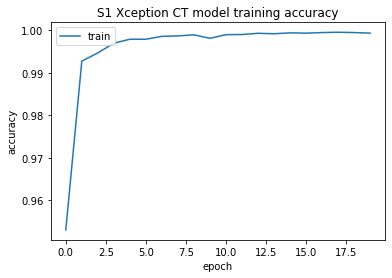

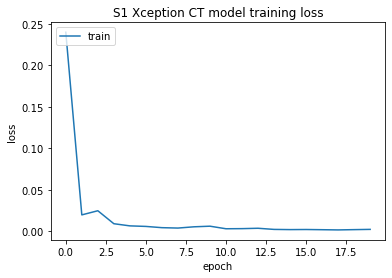

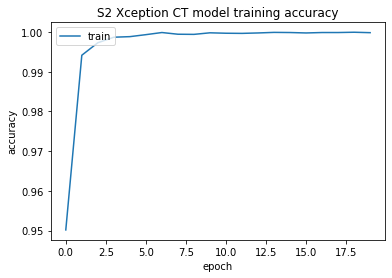

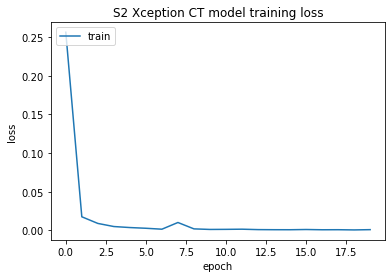

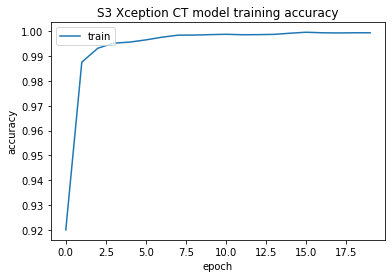

...

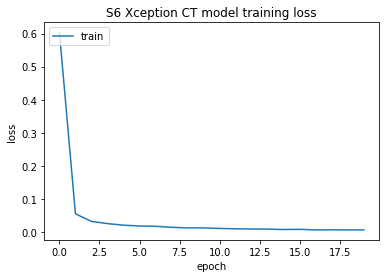

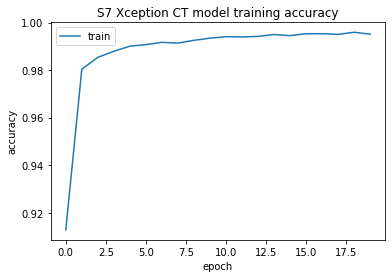

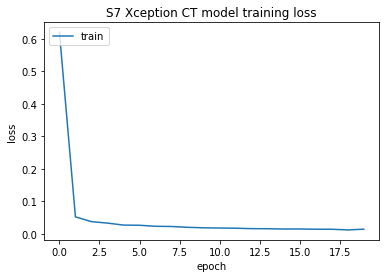

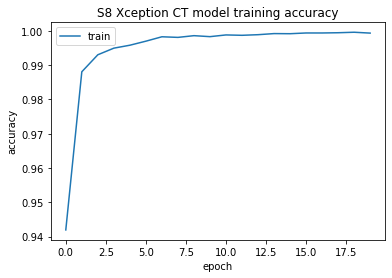

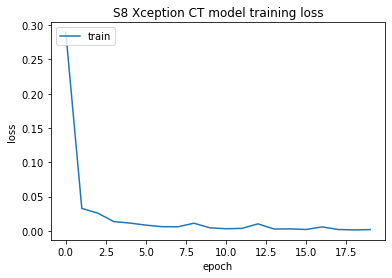

In [4]:
for vid in vid_list:
    # summarize history for accuracy
    plt.plot(trainhist_dict[vid]['accuracy'])
    plt.title('S%d %s CT model training accuracy'%(vid, winners_dict[vid]))
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()
    # summarize history for loss
    plt.plot(trainhist_dict[vid]['loss'])
    plt.title('S%d %s CT model training loss'%(vid, winners_dict[vid]))
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper left')
    plt.show()

## Convert soft preds to hard preds

In [5]:
y_hardpreds_dict={}
for i in vid_list:
    y_hardpreds_dict[i]=[np.argmax(j) for j in y_preds_dict[i]]

## Confusion Matrices

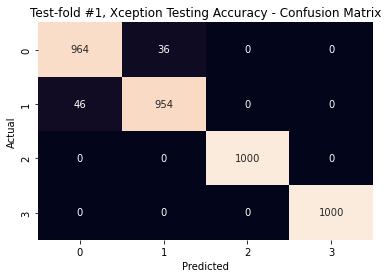

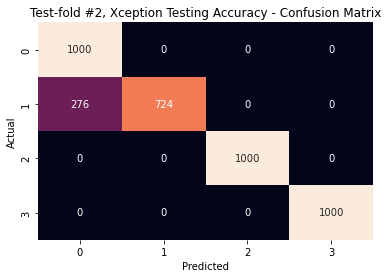

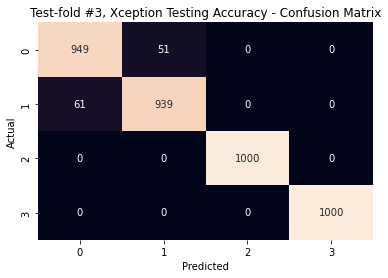

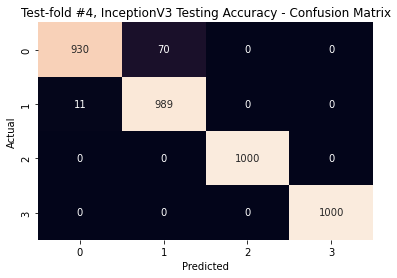

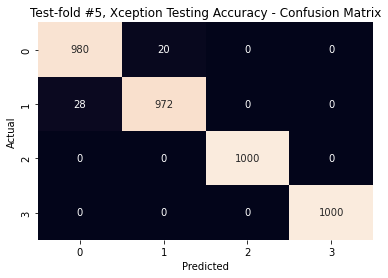

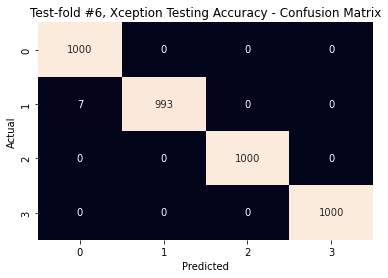

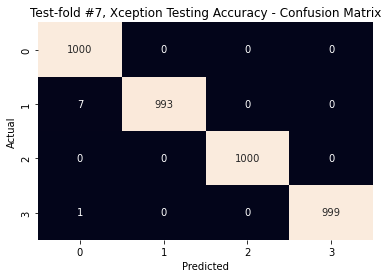

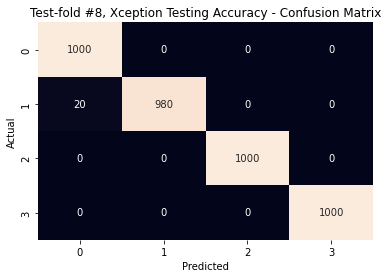

In [6]:
dfconfuse_dict = {}
for i in vid_list:
    temp_dict={'y_test': y_test_dict[i], 'y_pred': y_hardpreds_dict[i]}
    dftemp=pd.DataFrame(temp_dict, columns=['y_test', 'y_pred'])
    dfconfuse_dict[i] = pd.crosstab(dftemp['y_test'], dftemp['y_pred'], rownames=['Actual'], colnames=['Predicted'], margins=False)

cmat_path_export=results_path+'cmat_20210817/'
for i in vid_list:
    print()
    ax = plt.axes()
    ax.set_title('Test-fold #%d, %s Testing Accuracy - Confusion Matrix'%(i, winners_dict[i]))
    sn.heatmap(dfconfuse_dict[i], annot=True, fmt='g', cbar=False, xticklabels=True, yticklabels=True)
    plt.show()

## Look at testing image with prediction (left) alongside confidence of prediction (right)

S1, idx=2010, pred=fat, actual=muscle


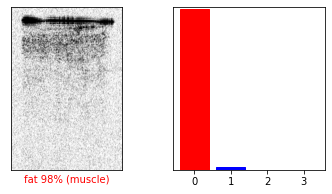

S1, idx=2019, pred=fat, actual=muscle


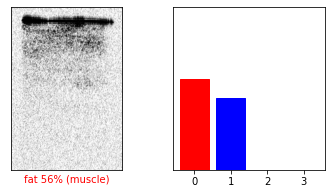

S1, idx=2021, pred=fat, actual=muscle


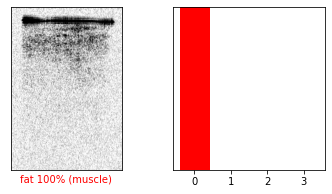

S1, idx=2044, pred=fat, actual=muscle


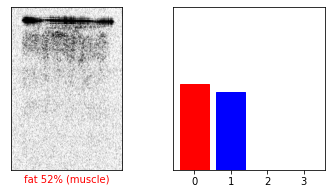

S1, idx=2122, pred=fat, actual=muscle


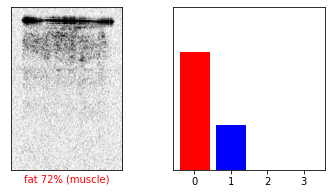

S1, idx=2150, pred=fat, actual=muscle


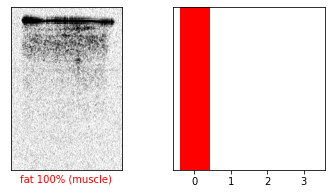

S1, idx=2152, pred=fat, actual=muscle


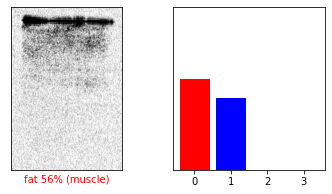

S1, idx=2259, pred=fat, actual=muscle


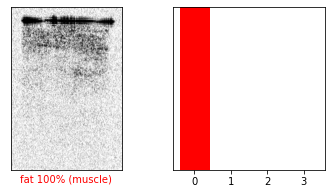

S1, idx=2285, pred=fat, actual=muscle


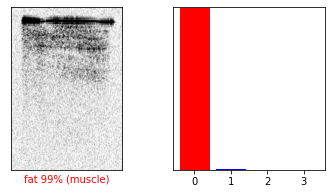

S1, idx=2291, pred=fat, actual=muscle


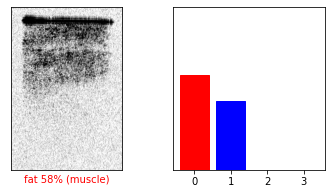

S1, idx=2293, pred=fat, actual=muscle


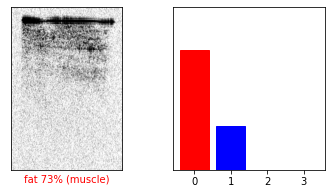

S1, idx=2302, pred=fat, actual=muscle


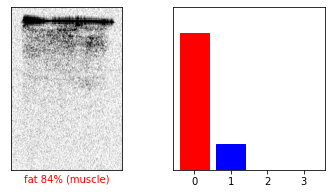

S1, idx=2308, pred=fat, actual=muscle


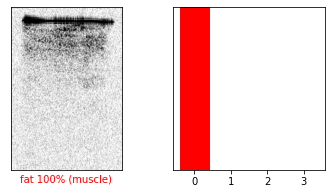

S1, idx=2313, pred=fat, actual=muscle


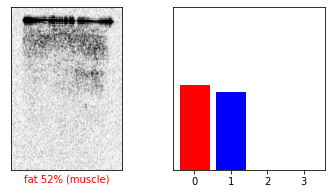

S1, idx=2316, pred=fat, actual=muscle


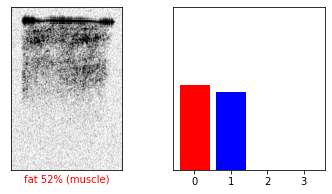

S1, idx=2333, pred=fat, actual=muscle


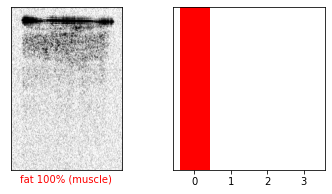

S1, idx=2388, pred=fat, actual=muscle


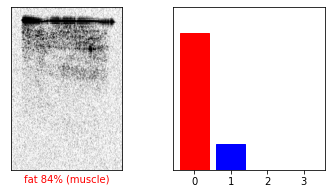

S1, idx=2397, pred=fat, actual=muscle


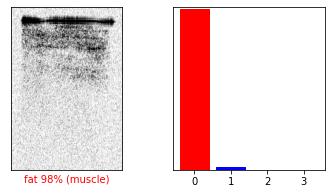

S1, idx=2416, pred=fat, actual=muscle


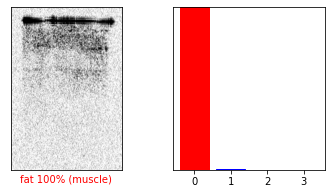

S1, idx=2423, pred=fat, actual=muscle


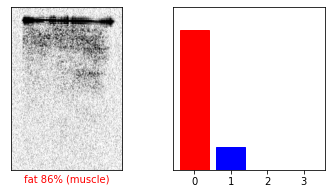

S1, idx=2446, pred=fat, actual=muscle


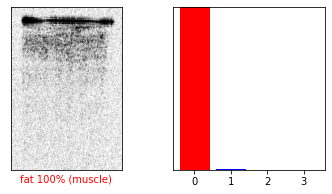

S1, idx=2468, pred=fat, actual=muscle


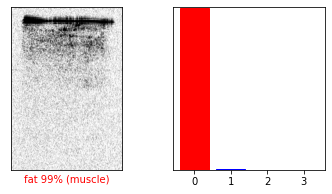

S1, idx=2475, pred=fat, actual=muscle


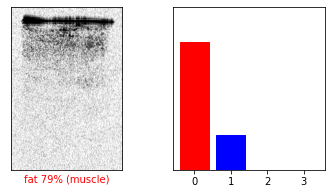

S1, idx=2495, pred=fat, actual=muscle


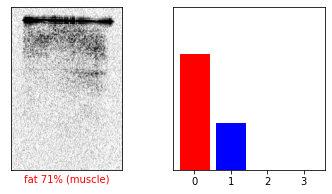

S1, idx=2498, pred=fat, actual=muscle


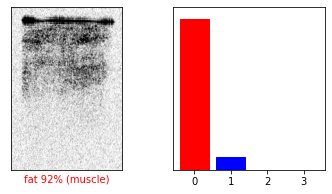

S1, idx=2505, pred=fat, actual=muscle


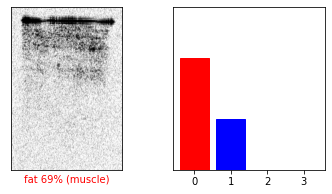

S1, idx=2544, pred=fat, actual=muscle


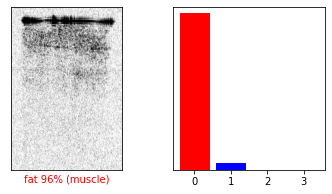

S1, idx=2621, pred=fat, actual=muscle


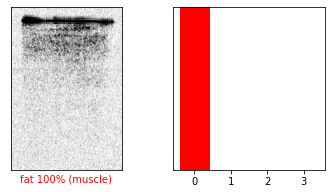

S1, idx=2622, pred=fat, actual=muscle


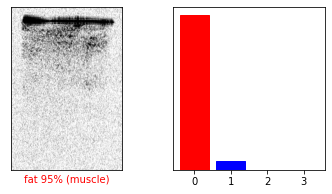

S1, idx=2631, pred=fat, actual=muscle


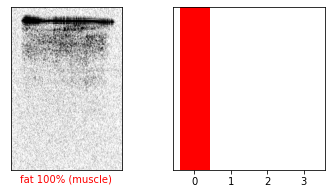

S1, idx=2634, pred=fat, actual=muscle


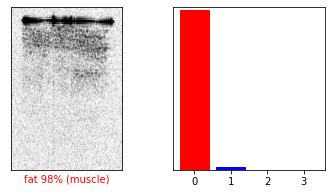

S1, idx=2641, pred=fat, actual=muscle


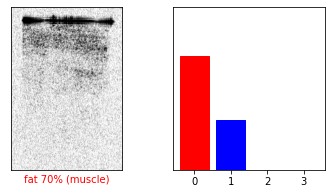

S1, idx=2671, pred=fat, actual=muscle


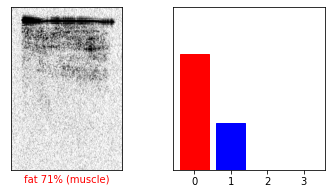

S1, idx=2679, pred=fat, actual=muscle


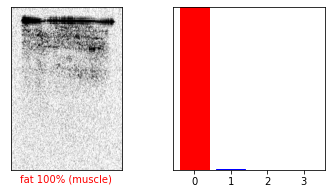

S1, idx=2711, pred=fat, actual=muscle


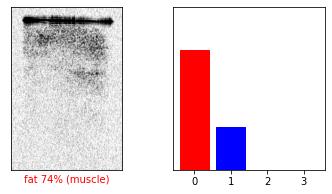

S1, idx=2717, pred=fat, actual=muscle


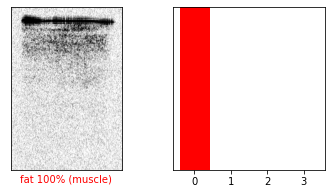

S1, idx=2726, pred=fat, actual=muscle


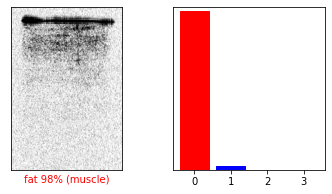

S1, idx=2790, pred=fat, actual=muscle


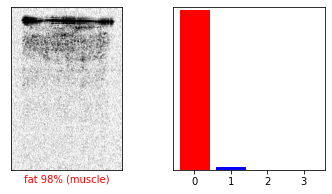

S1, idx=2805, pred=fat, actual=muscle


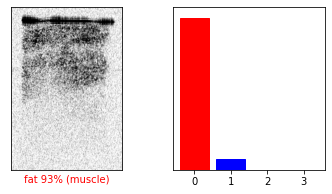

S1, idx=2807, pred=fat, actual=muscle


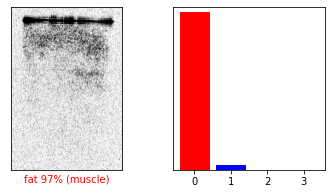

S1, idx=2819, pred=fat, actual=muscle


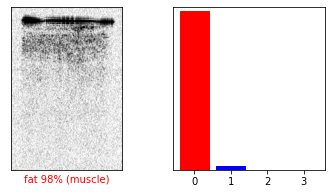

S1, idx=2829, pred=fat, actual=muscle


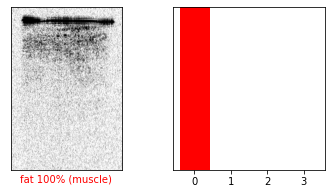

S1, idx=2860, pred=fat, actual=muscle


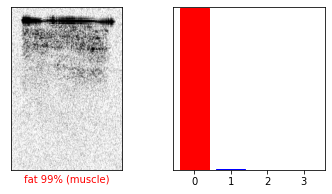

S1, idx=2896, pred=fat, actual=muscle


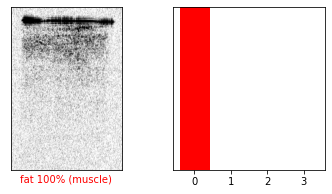

S1, idx=2907, pred=fat, actual=muscle


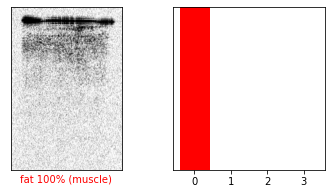

S1, idx=2951, pred=fat, actual=muscle


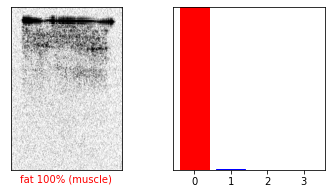

S1, idx=3015, pred=muscle, actual=fat


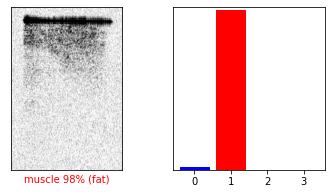

S1, idx=3026, pred=muscle, actual=fat


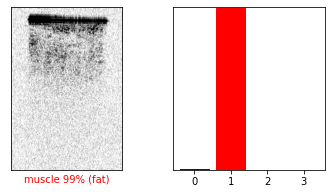

S1, idx=3086, pred=muscle, actual=fat


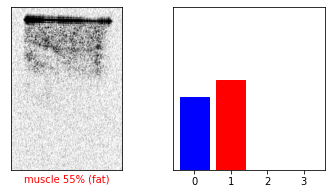

S1, idx=3095, pred=muscle, actual=fat


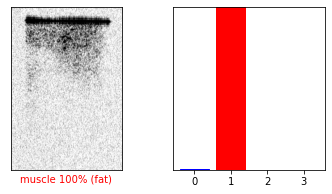

S1, idx=3157, pred=muscle, actual=fat


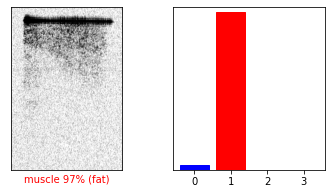

S1, idx=3168, pred=muscle, actual=fat


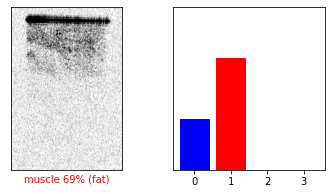

S1, idx=3172, pred=muscle, actual=fat


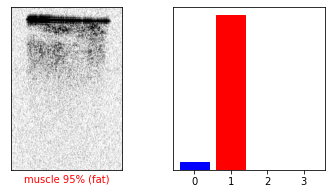

S1, idx=3182, pred=muscle, actual=fat


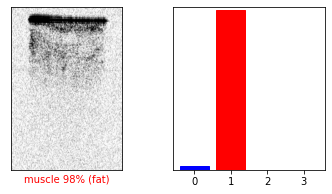

S1, idx=3243, pred=muscle, actual=fat


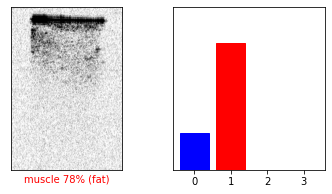

S1, idx=3252, pred=muscle, actual=fat


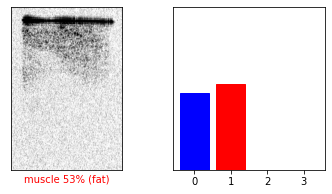

S1, idx=3255, pred=muscle, actual=fat


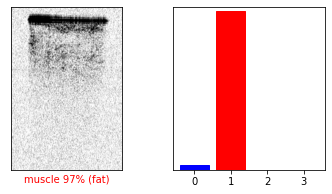

S1, idx=3273, pred=muscle, actual=fat


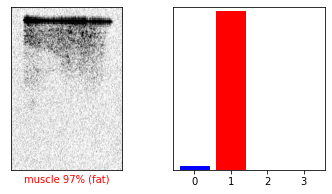

S1, idx=3312, pred=muscle, actual=fat


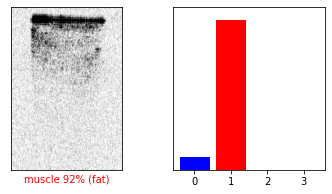

S1, idx=3322, pred=muscle, actual=fat


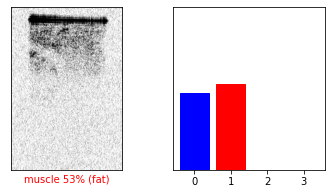

S1, idx=3338, pred=muscle, actual=fat


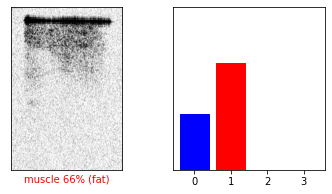

S1, idx=3359, pred=muscle, actual=fat


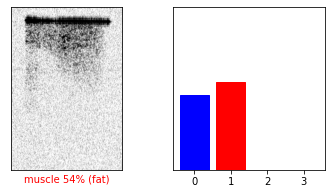

S1, idx=3412, pred=muscle, actual=fat


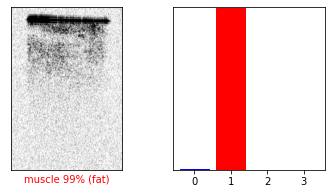

S1, idx=3415, pred=muscle, actual=fat


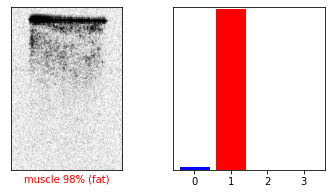

S1, idx=3424, pred=muscle, actual=fat


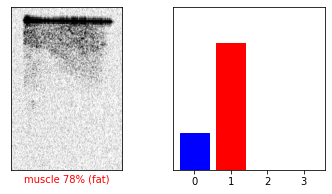

S1, idx=3467, pred=muscle, actual=fat


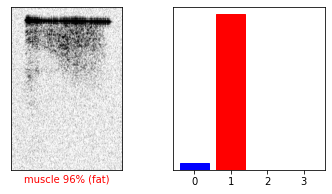

S1, idx=3479, pred=muscle, actual=fat


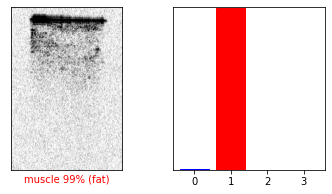

S1, idx=3545, pred=muscle, actual=fat


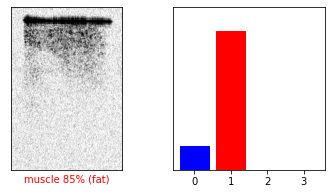

S1, idx=3557, pred=muscle, actual=fat


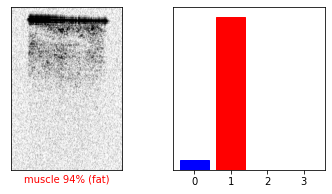

S1, idx=3567, pred=muscle, actual=fat


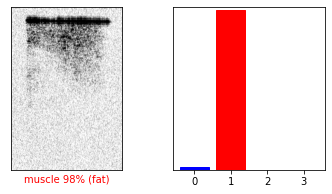

S1, idx=3638, pred=muscle, actual=fat


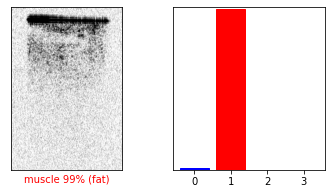

S1, idx=3708, pred=muscle, actual=fat


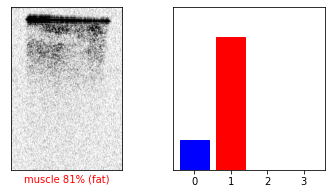

S1, idx=3711, pred=muscle, actual=fat


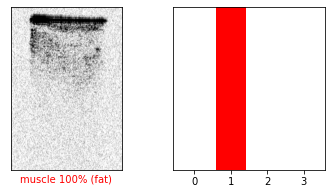

S1, idx=3714, pred=muscle, actual=fat


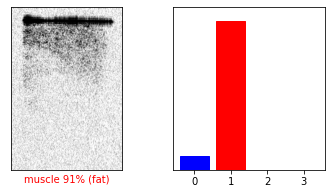

S1, idx=3789, pred=muscle, actual=fat


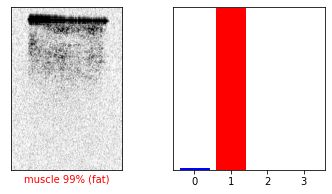

S1, idx=3828, pred=muscle, actual=fat


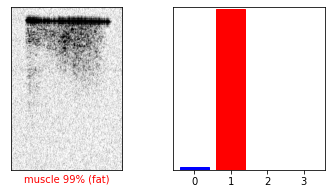

S1, idx=3881, pred=muscle, actual=fat


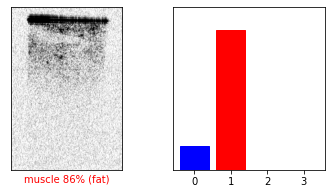

S1, idx=3896, pred=muscle, actual=fat


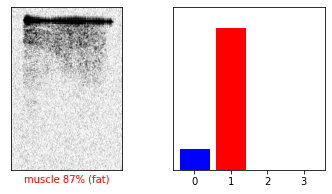

S1, idx=3940, pred=muscle, actual=fat


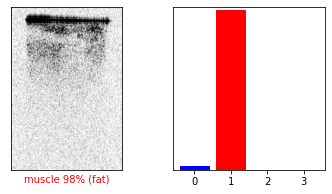

S1, idx=3952, pred=muscle, actual=fat


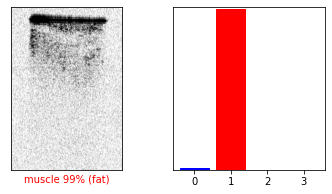

S1, idx=3955, pred=muscle, actual=fat


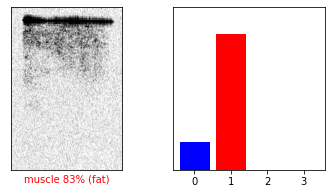

S1, idx=3996, pred=muscle, actual=fat


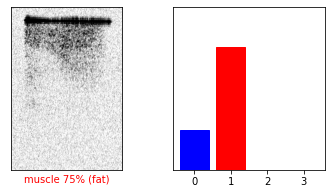

S2, idx=3004, pred=fat, actual=muscle


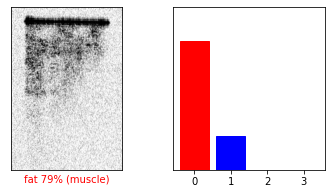

S2, idx=3005, pred=fat, actual=muscle


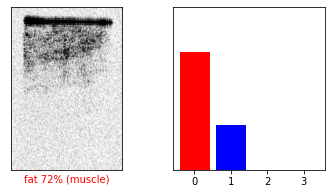

S2, idx=3020, pred=fat, actual=muscle


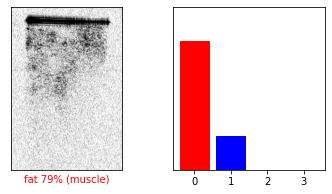

S2, idx=3021, pred=fat, actual=muscle


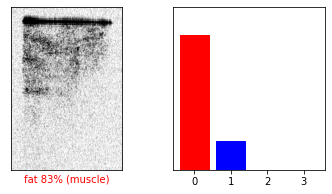

S2, idx=3029, pred=fat, actual=muscle


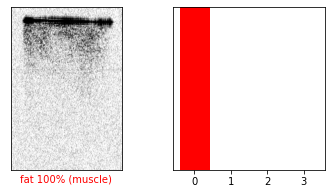

S2, idx=3033, pred=fat, actual=muscle


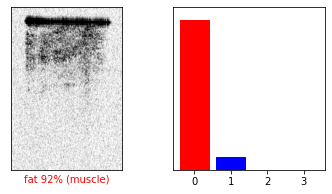

S2, idx=3037, pred=fat, actual=muscle


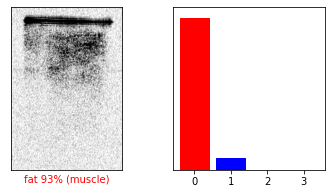

S2, idx=3044, pred=fat, actual=muscle


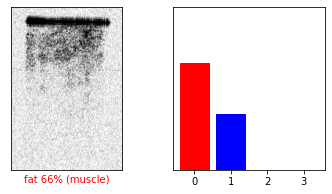

S2, idx=3046, pred=fat, actual=muscle


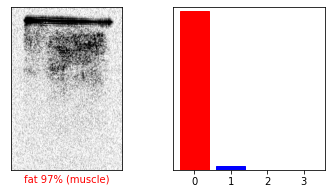

S2, idx=3048, pred=fat, actual=muscle


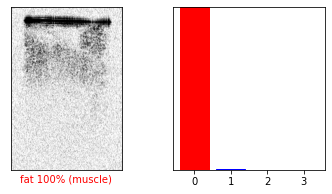

S2, idx=3050, pred=fat, actual=muscle


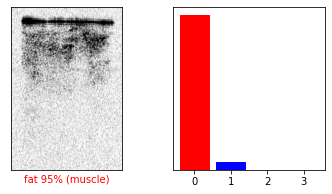

S2, idx=3052, pred=fat, actual=muscle


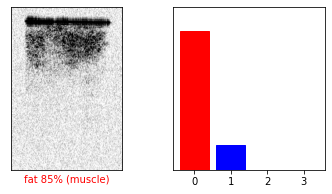

S2, idx=3060, pred=fat, actual=muscle


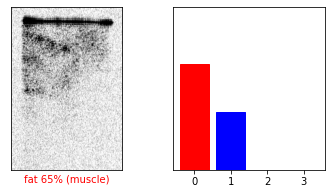

S2, idx=3062, pred=fat, actual=muscle


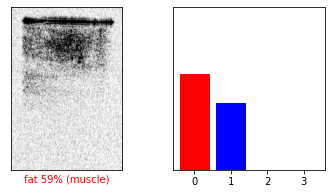

S2, idx=3063, pred=fat, actual=muscle


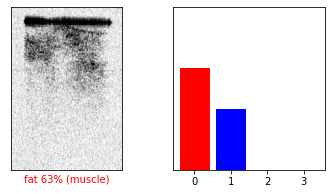

S2, idx=3071, pred=fat, actual=muscle


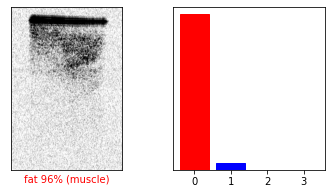

S2, idx=3072, pred=fat, actual=muscle


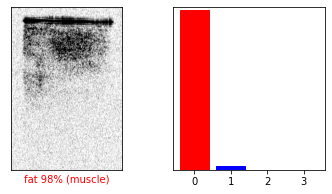

S2, idx=3073, pred=fat, actual=muscle


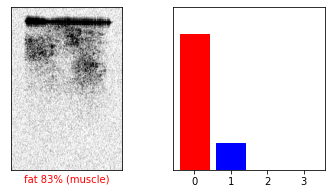

S2, idx=3080, pred=fat, actual=muscle


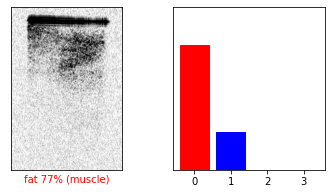

S2, idx=3083, pred=fat, actual=muscle


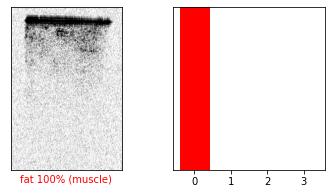

S2, idx=3084, pred=fat, actual=muscle


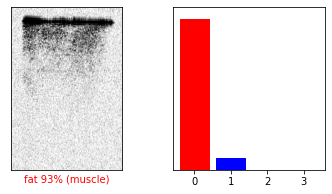

S2, idx=3085, pred=fat, actual=muscle


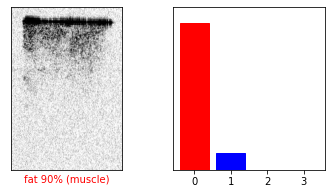

S2, idx=3091, pred=fat, actual=muscle


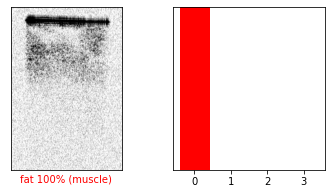

S2, idx=3097, pred=fat, actual=muscle


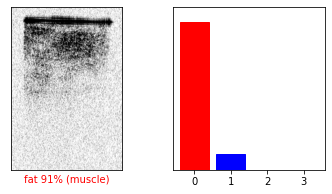

S2, idx=3098, pred=fat, actual=muscle


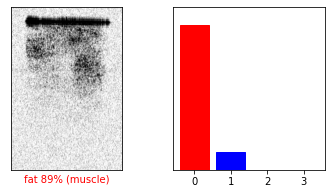

S2, idx=3101, pred=fat, actual=muscle


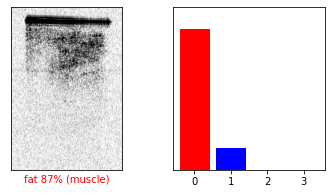

S2, idx=3107, pred=fat, actual=muscle


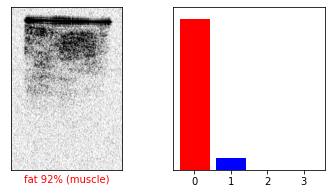

S2, idx=3110, pred=fat, actual=muscle


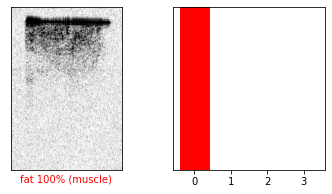

S2, idx=3111, pred=fat, actual=muscle


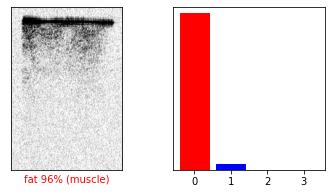

S2, idx=3113, pred=fat, actual=muscle


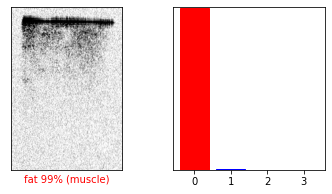

S2, idx=3116, pred=fat, actual=muscle


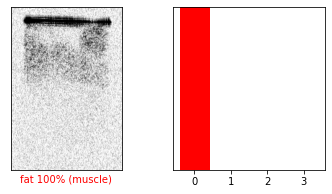

S2, idx=3118, pred=fat, actual=muscle


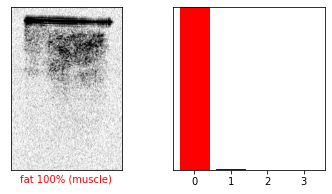

S2, idx=3125, pred=fat, actual=muscle


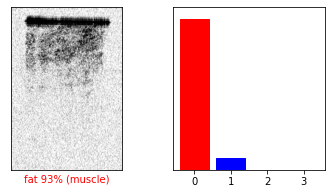

S2, idx=3126, pred=fat, actual=muscle


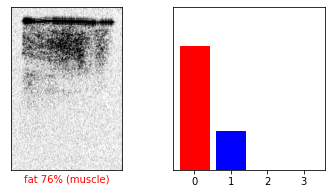

S2, idx=3128, pred=fat, actual=muscle


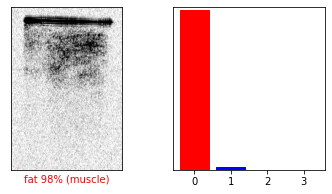

S2, idx=3136, pred=fat, actual=muscle


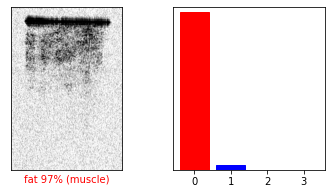

S2, idx=3139, pred=fat, actual=muscle


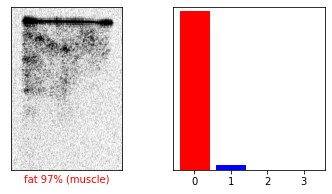

S2, idx=3143, pred=fat, actual=muscle


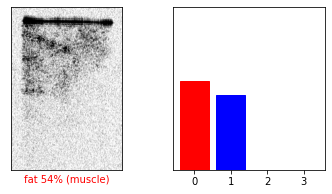

S2, idx=3144, pred=fat, actual=muscle


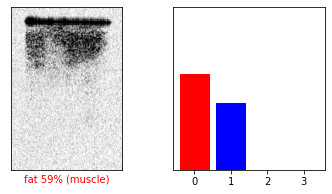

S2, idx=3155, pred=fat, actual=muscle


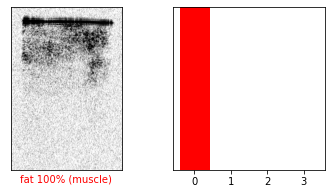

S2, idx=3157, pred=fat, actual=muscle


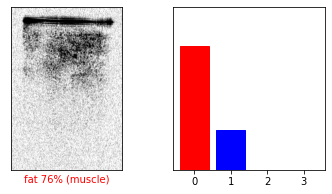

S2, idx=3164, pred=fat, actual=muscle


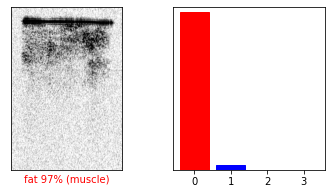

S2, idx=3170, pred=fat, actual=muscle


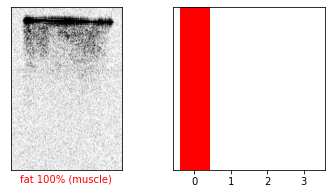

S2, idx=3176, pred=fat, actual=muscle


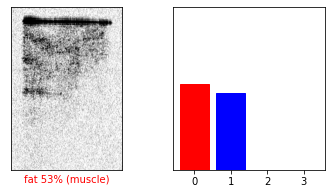

S2, idx=3177, pred=fat, actual=muscle


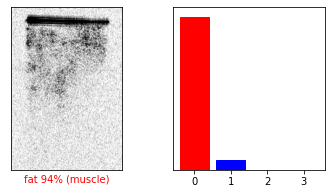

S2, idx=3184, pred=fat, actual=muscle


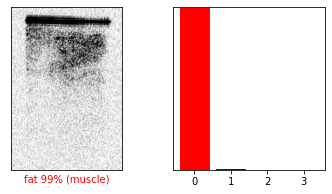

S2, idx=3191, pred=fat, actual=muscle


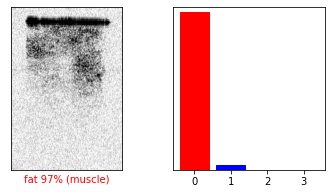

S2, idx=3192, pred=fat, actual=muscle


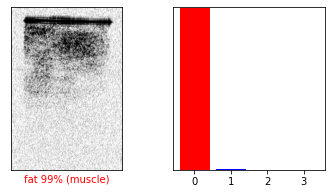

S2, idx=3194, pred=fat, actual=muscle


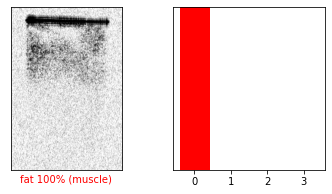

S2, idx=3195, pred=fat, actual=muscle


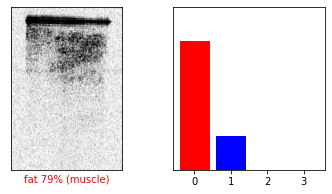

S2, idx=3200, pred=fat, actual=muscle


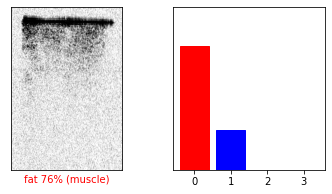

S2, idx=3201, pred=fat, actual=muscle


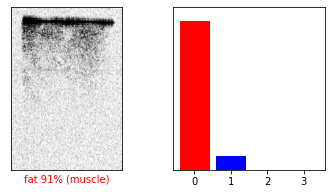

S2, idx=3203, pred=fat, actual=muscle


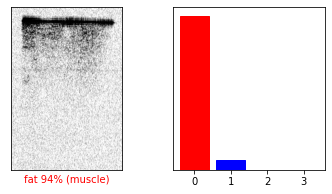

S2, idx=3205, pred=fat, actual=muscle


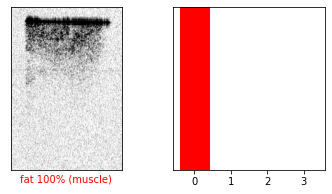

S2, idx=3209, pred=fat, actual=muscle


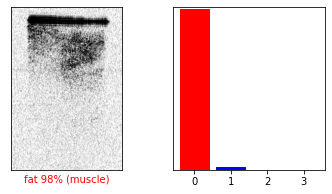

S2, idx=3212, pred=fat, actual=muscle


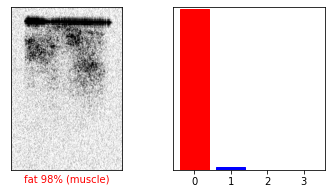

S2, idx=3218, pred=fat, actual=muscle


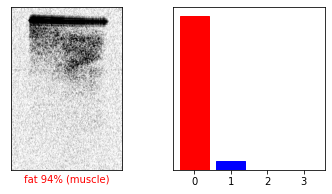

S2, idx=3222, pred=fat, actual=muscle


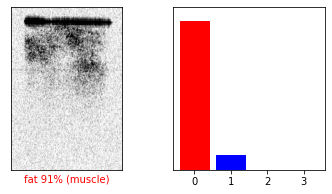

S2, idx=3228, pred=fat, actual=muscle


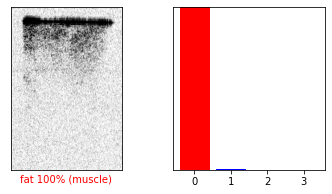

S2, idx=3231, pred=fat, actual=muscle


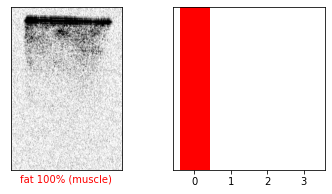

S2, idx=3239, pred=fat, actual=muscle


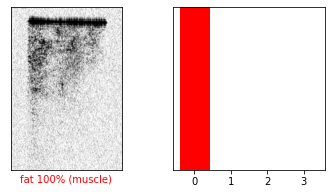

S2, idx=3242, pred=fat, actual=muscle


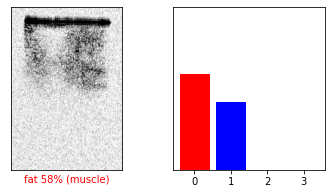

S2, idx=3243, pred=fat, actual=muscle


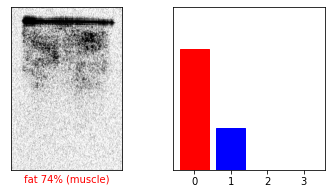

S2, idx=3245, pred=fat, actual=muscle


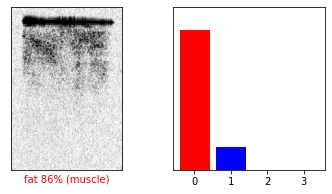

S2, idx=3246, pred=fat, actual=muscle


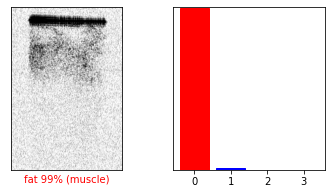

S2, idx=3248, pred=fat, actual=muscle


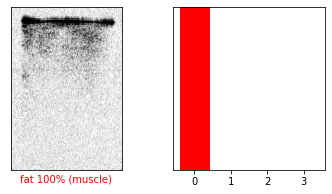

S2, idx=3249, pred=fat, actual=muscle


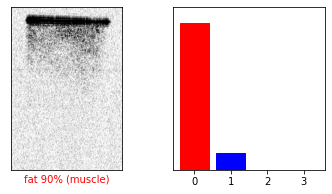

S2, idx=3251, pred=fat, actual=muscle


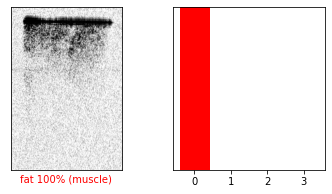

S2, idx=3255, pred=fat, actual=muscle


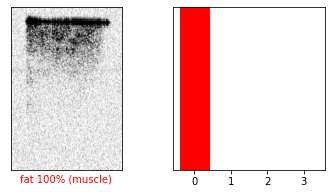

S2, idx=3257, pred=fat, actual=muscle


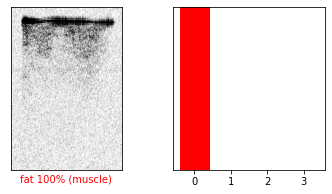

S2, idx=3258, pred=fat, actual=muscle


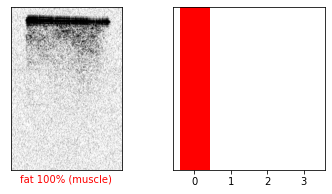

S2, idx=3262, pred=fat, actual=muscle


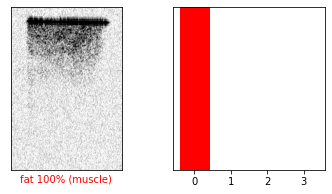

S2, idx=3264, pred=fat, actual=muscle


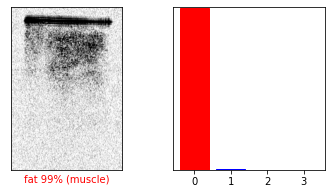

S2, idx=3267, pred=fat, actual=muscle


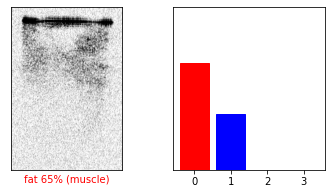

S2, idx=3268, pred=fat, actual=muscle


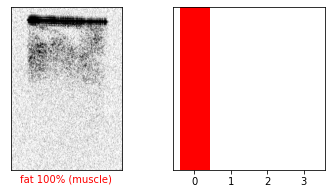

S2, idx=3273, pred=fat, actual=muscle


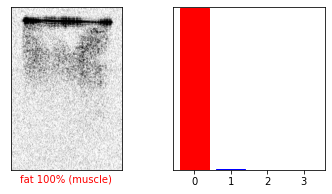

S2, idx=3274, pred=fat, actual=muscle


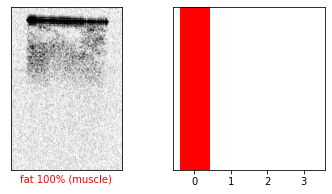

S2, idx=3275, pred=fat, actual=muscle


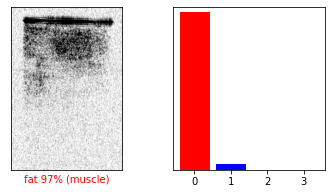

S2, idx=3281, pred=fat, actual=muscle


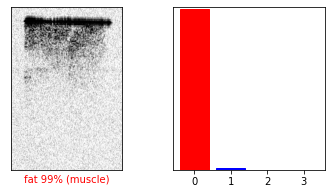

S2, idx=3286, pred=fat, actual=muscle


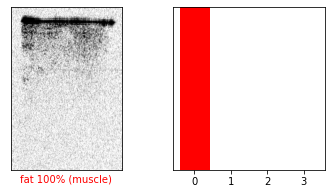

S2, idx=3289, pred=fat, actual=muscle


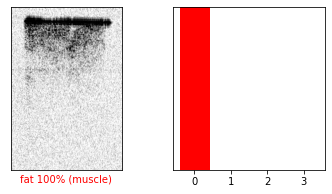

S2, idx=3292, pred=fat, actual=muscle


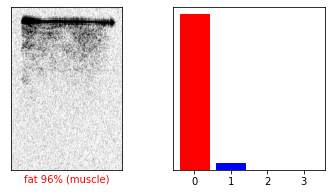

S2, idx=3293, pred=fat, actual=muscle


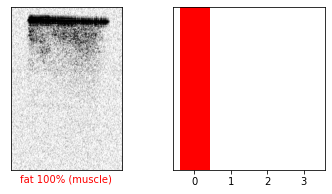

S2, idx=3297, pred=fat, actual=muscle


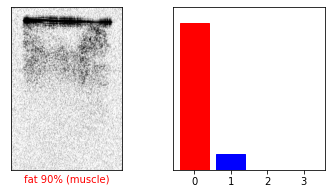

S2, idx=3299, pred=fat, actual=muscle


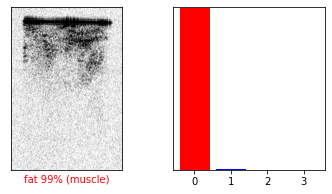

S2, idx=3300, pred=fat, actual=muscle


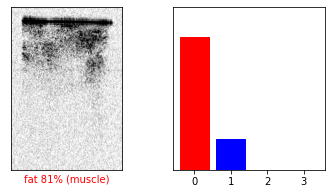

S2, idx=3303, pred=fat, actual=muscle


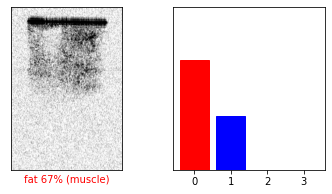

S2, idx=3304, pred=fat, actual=muscle


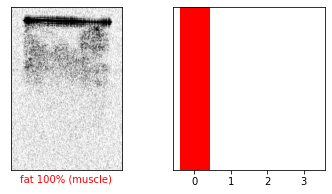

S2, idx=3305, pred=fat, actual=muscle


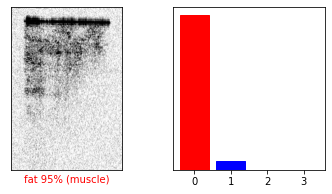

S2, idx=3313, pred=fat, actual=muscle


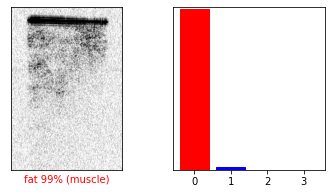

S2, idx=3317, pred=fat, actual=muscle


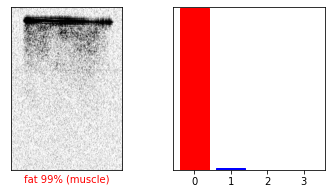

S2, idx=3324, pred=fat, actual=muscle


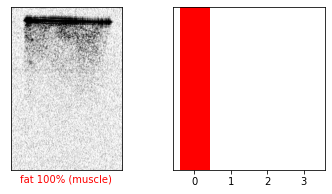

S2, idx=3332, pred=fat, actual=muscle


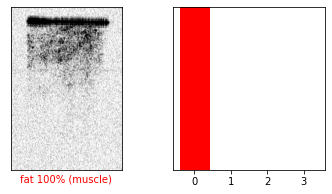

S2, idx=3338, pred=fat, actual=muscle


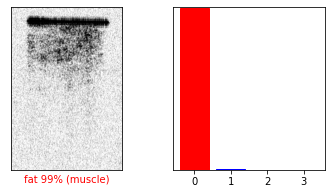

S2, idx=3339, pred=fat, actual=muscle


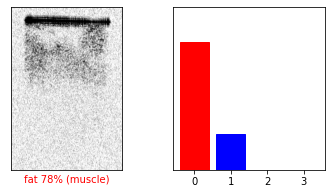

S2, idx=3340, pred=fat, actual=muscle


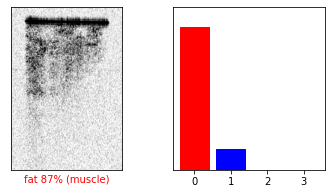

S2, idx=3347, pred=fat, actual=muscle


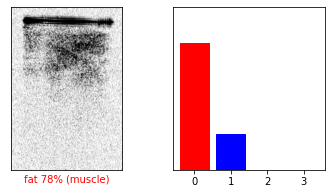

S2, idx=3348, pred=fat, actual=muscle


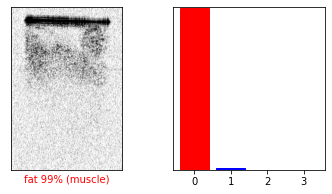

S2, idx=3349, pred=fat, actual=muscle


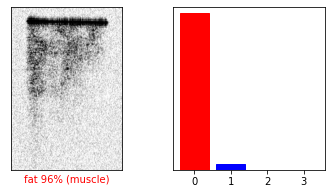

S2, idx=3352, pred=fat, actual=muscle


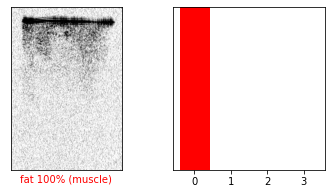

S2, idx=3353, pred=fat, actual=muscle


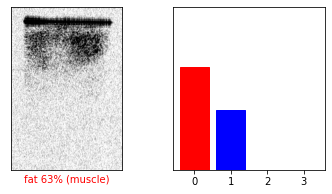

S2, idx=3357, pred=fat, actual=muscle


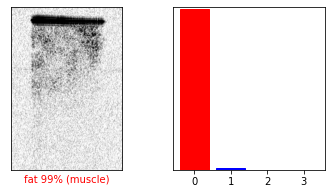

S2, idx=3362, pred=fat, actual=muscle


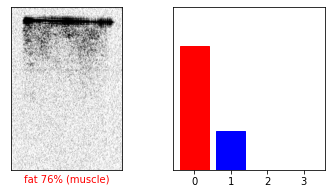

S2, idx=3365, pred=fat, actual=muscle


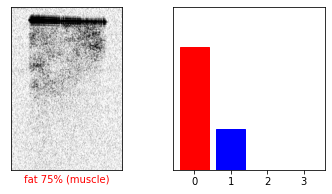

S2, idx=3368, pred=fat, actual=muscle


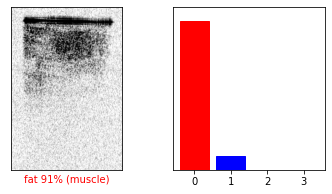

S2, idx=3371, pred=fat, actual=muscle


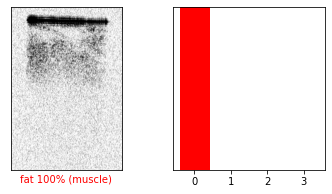

S2, idx=3372, pred=fat, actual=muscle


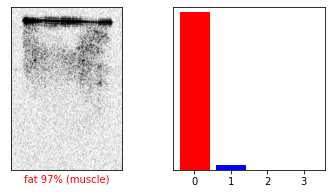

S2, idx=3378, pred=fat, actual=muscle


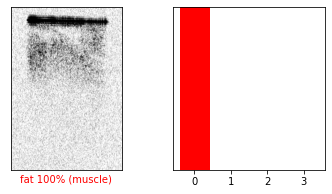

S2, idx=3379, pred=fat, actual=muscle


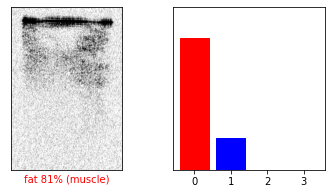

S2, idx=3382, pred=fat, actual=muscle


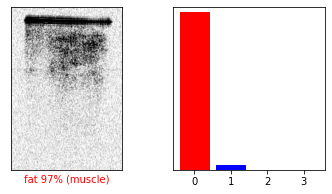

S2, idx=3387, pred=fat, actual=muscle


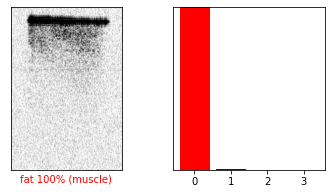

S2, idx=3388, pred=fat, actual=muscle


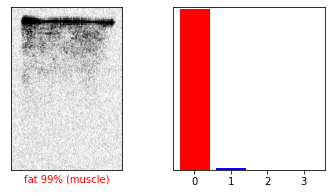

S2, idx=3389, pred=fat, actual=muscle


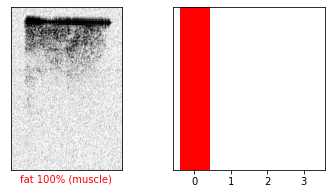

S2, idx=3394, pred=fat, actual=muscle


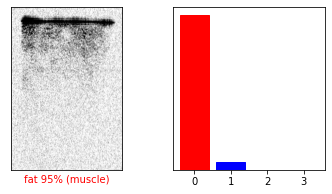

S2, idx=3397, pred=fat, actual=muscle


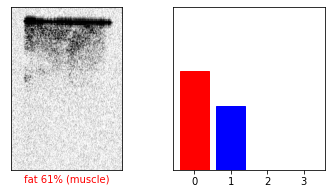

S2, idx=3399, pred=fat, actual=muscle


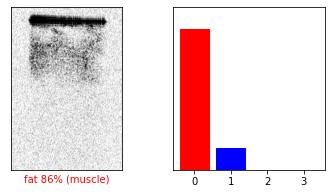

S2, idx=3407, pred=fat, actual=muscle


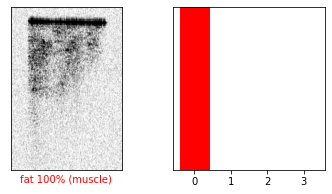

S2, idx=3408, pred=fat, actual=muscle


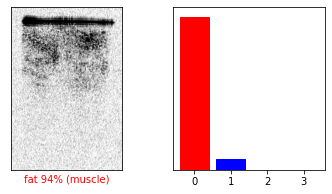

S2, idx=3415, pred=fat, actual=muscle


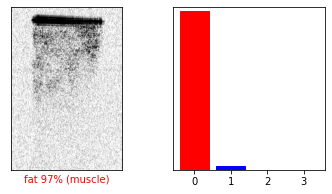

S2, idx=3417, pred=fat, actual=muscle


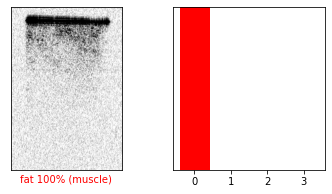

S2, idx=3418, pred=fat, actual=muscle


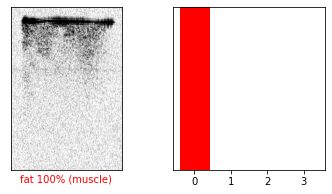

S2, idx=3422, pred=fat, actual=muscle


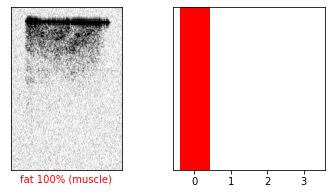

S2, idx=3424, pred=fat, actual=muscle


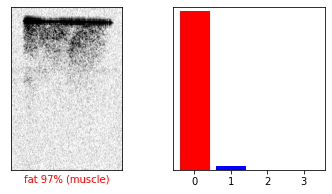

S2, idx=3426, pred=fat, actual=muscle


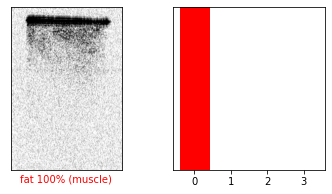

S2, idx=3427, pred=fat, actual=muscle


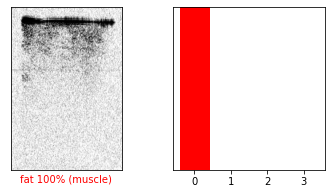

S2, idx=3432, pred=fat, actual=muscle


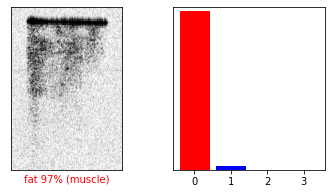

S2, idx=3433, pred=fat, actual=muscle


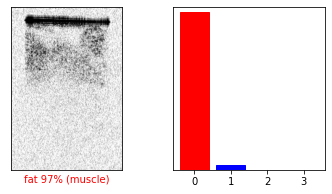

S2, idx=3434, pred=fat, actual=muscle


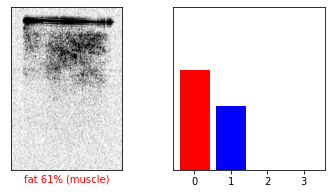

S2, idx=3440, pred=fat, actual=muscle


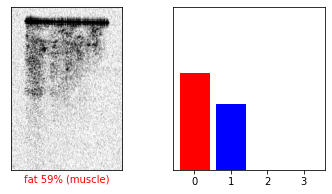

S2, idx=3441, pred=fat, actual=muscle


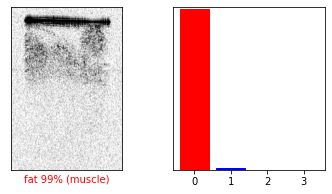

S2, idx=3445, pred=fat, actual=muscle


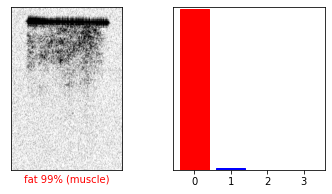

S2, idx=3449, pred=fat, actual=muscle


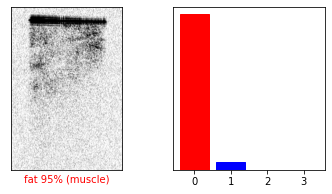

S2, idx=3454, pred=fat, actual=muscle


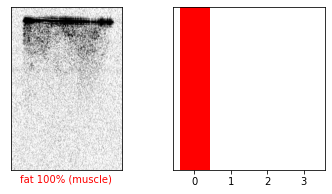

S2, idx=3457, pred=fat, actual=muscle


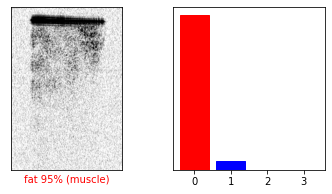

S2, idx=3464, pred=fat, actual=muscle


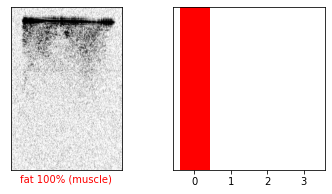

S2, idx=3470, pred=fat, actual=muscle


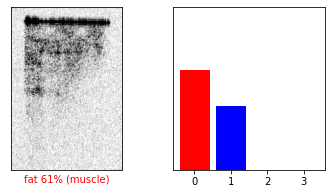

S2, idx=3471, pred=fat, actual=muscle


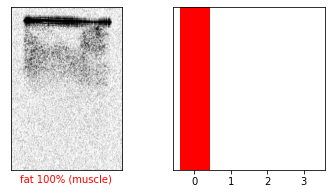

S2, idx=3473, pred=fat, actual=muscle


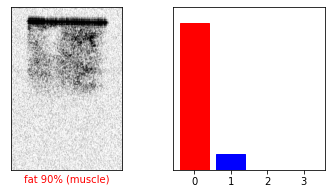

S2, idx=3477, pred=fat, actual=muscle


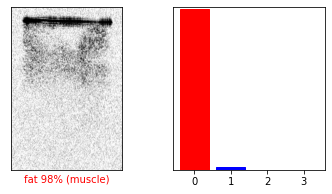

S2, idx=3479, pred=fat, actual=muscle


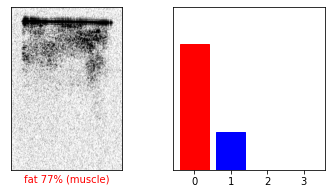

S2, idx=3480, pred=fat, actual=muscle


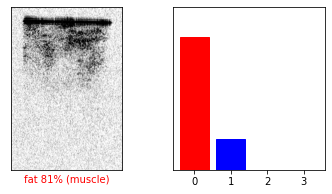

S2, idx=3484, pred=fat, actual=muscle


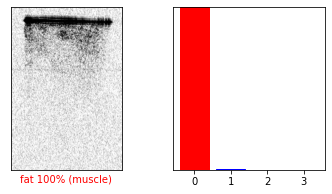

S2, idx=3490, pred=fat, actual=muscle


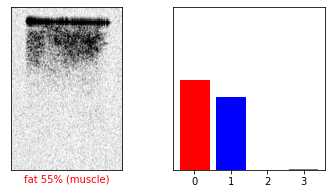

S2, idx=3492, pred=fat, actual=muscle


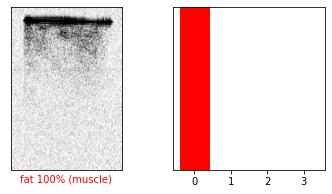

S2, idx=3498, pred=fat, actual=muscle


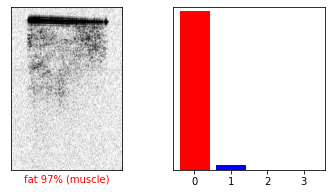

S2, idx=3501, pred=fat, actual=muscle


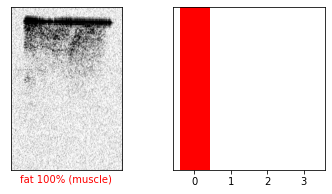

S2, idx=3507, pred=fat, actual=muscle


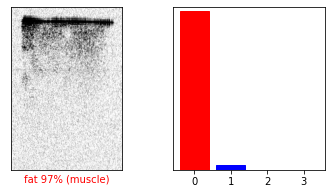

S2, idx=3510, pred=fat, actual=muscle


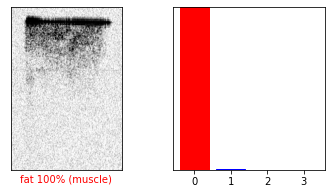

S2, idx=3513, pred=fat, actual=muscle


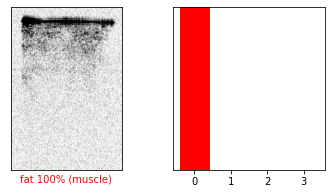

S2, idx=3518, pred=fat, actual=muscle


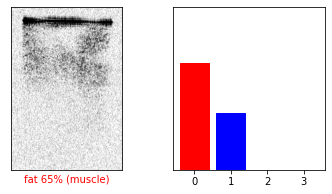

S2, idx=3519, pred=fat, actual=muscle


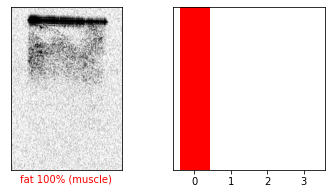

S2, idx=3527, pred=fat, actual=muscle


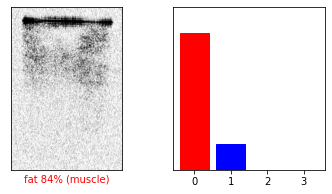

S2, idx=3528, pred=fat, actual=muscle


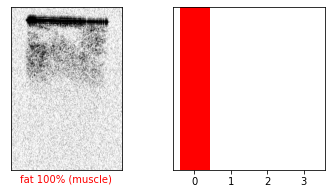

S2, idx=3533, pred=fat, actual=muscle


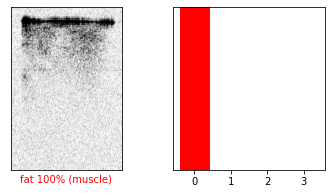

S2, idx=3534, pred=fat, actual=muscle


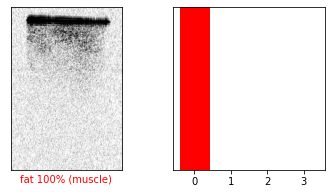

S2, idx=3539, pred=fat, actual=muscle


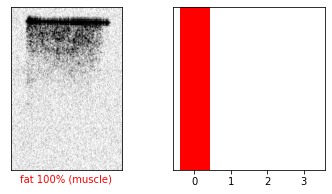

S2, idx=3541, pred=fat, actual=muscle


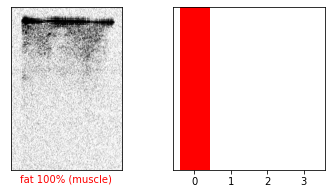

S2, idx=3542, pred=fat, actual=muscle


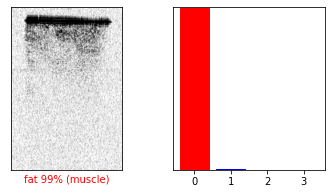

S2, idx=3546, pred=fat, actual=muscle


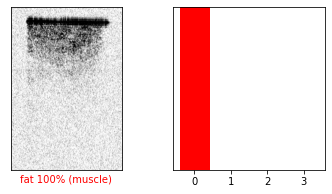

S2, idx=3552, pred=fat, actual=muscle


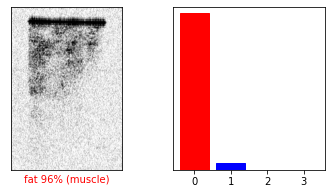

S2, idx=3553, pred=fat, actual=muscle


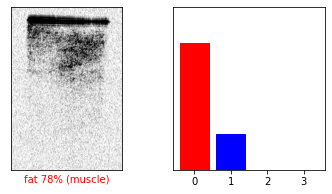

S2, idx=3560, pred=fat, actual=muscle


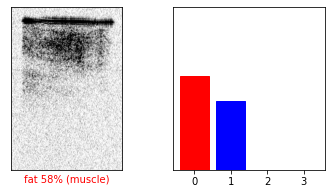

S2, idx=3562, pred=fat, actual=muscle


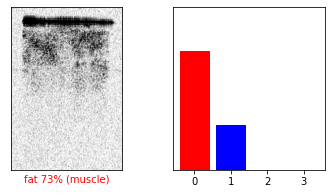

S2, idx=3563, pred=fat, actual=muscle


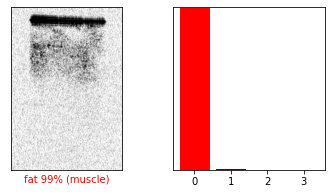

S2, idx=3566, pred=fat, actual=muscle


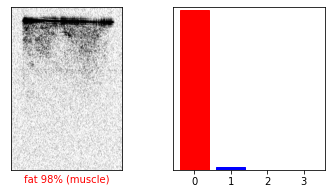

S2, idx=3572, pred=fat, actual=muscle


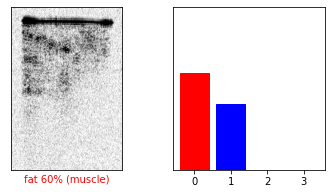

S2, idx=3573, pred=fat, actual=muscle


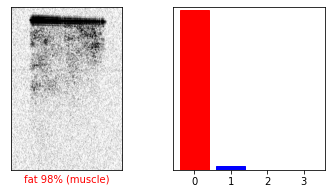

S2, idx=3579, pred=fat, actual=muscle


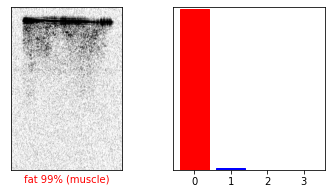

S2, idx=3582, pred=fat, actual=muscle


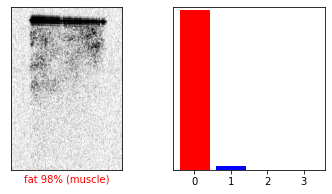

S2, idx=3587, pred=fat, actual=muscle


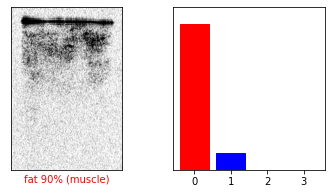

S2, idx=3589, pred=fat, actual=muscle


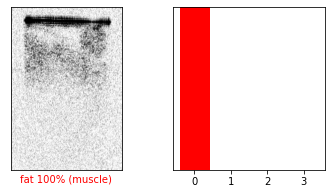

S2, idx=3590, pred=fat, actual=muscle


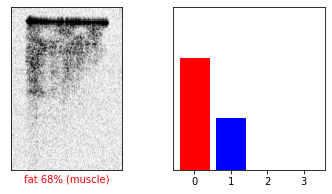

S2, idx=3591, pred=fat, actual=muscle


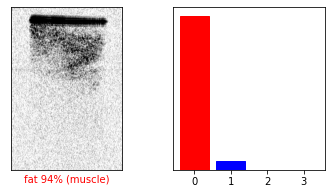

S2, idx=3599, pred=fat, actual=muscle


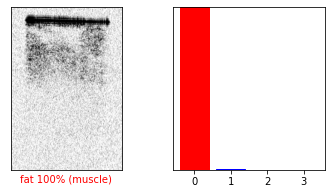

S2, idx=3600, pred=fat, actual=muscle


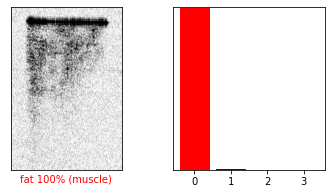

S2, idx=3602, pred=fat, actual=muscle


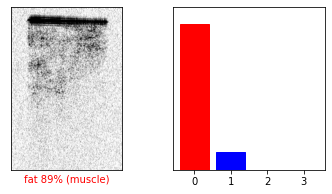

S2, idx=3605, pred=fat, actual=muscle


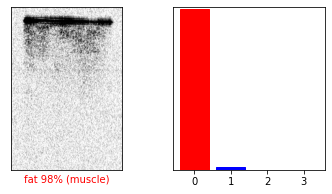

S2, idx=3611, pred=fat, actual=muscle


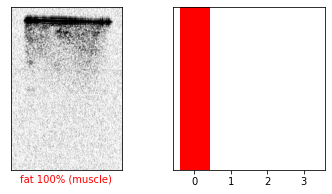

S2, idx=3617, pred=fat, actual=muscle


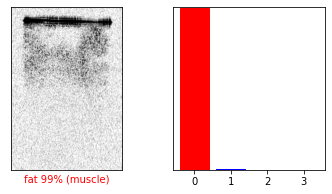

S2, idx=3626, pred=fat, actual=muscle


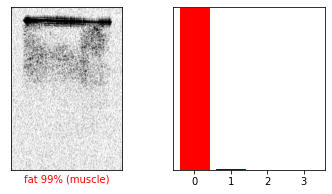

S2, idx=3630, pred=fat, actual=muscle


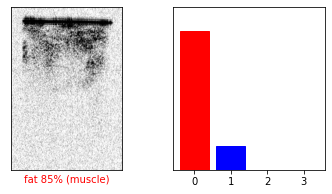

S2, idx=3634, pred=fat, actual=muscle


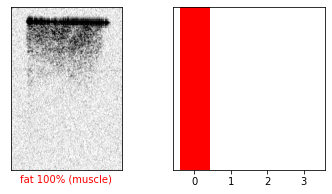

S2, idx=3636, pred=fat, actual=muscle


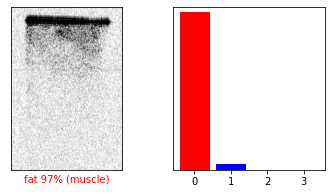

S2, idx=3637, pred=fat, actual=muscle


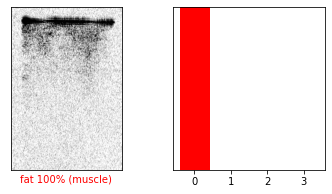

S2, idx=3641, pred=fat, actual=muscle


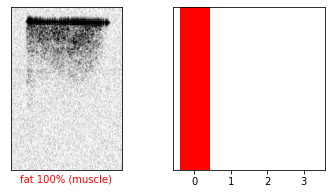

S2, idx=3644, pred=fat, actual=muscle


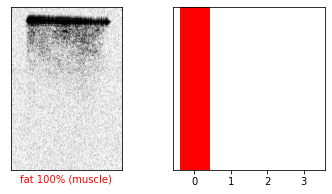

S2, idx=3645, pred=fat, actual=muscle


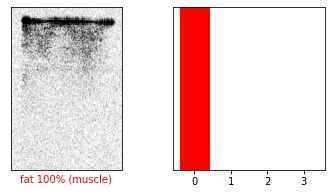

S2, idx=3648, pred=fat, actual=muscle


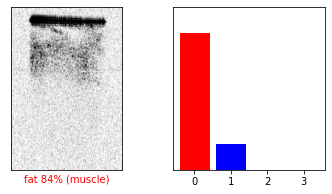

S2, idx=3649, pred=fat, actual=muscle


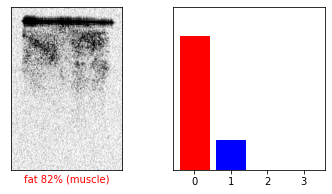

S2, idx=3657, pred=fat, actual=muscle


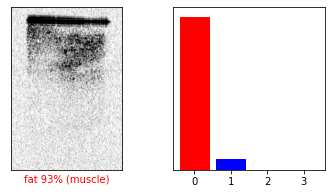

S2, idx=3658, pred=fat, actual=muscle


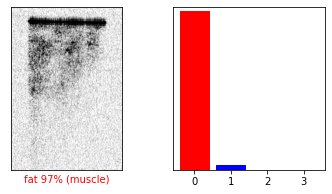

S2, idx=3670, pred=fat, actual=muscle


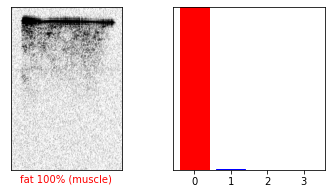

S2, idx=3671, pred=fat, actual=muscle


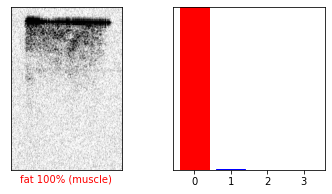

S2, idx=3676, pred=fat, actual=muscle


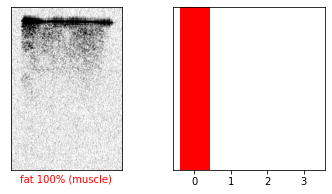

S2, idx=3677, pred=fat, actual=muscle


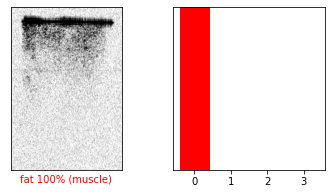

S2, idx=3680, pred=fat, actual=muscle


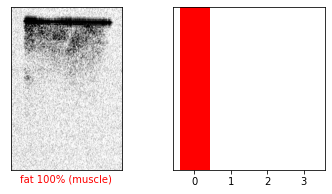

S2, idx=3687, pred=fat, actual=muscle


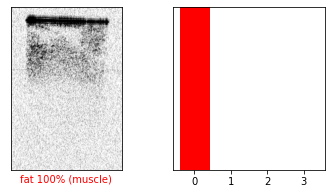

S2, idx=3688, pred=fat, actual=muscle


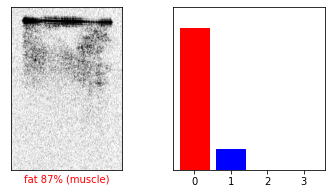

S2, idx=3695, pred=fat, actual=muscle


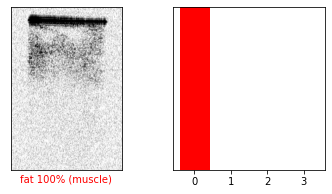

S2, idx=3696, pred=fat, actual=muscle


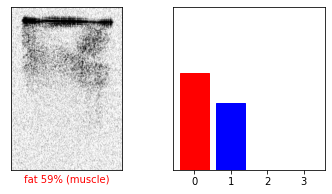

S2, idx=3701, pred=fat, actual=muscle


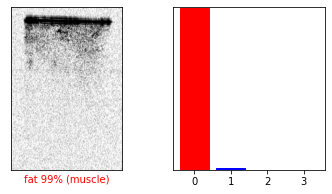

S2, idx=3704, pred=fat, actual=muscle


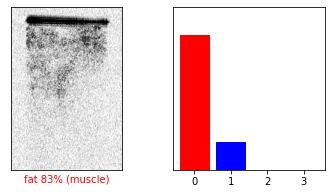

S2, idx=3707, pred=fat, actual=muscle


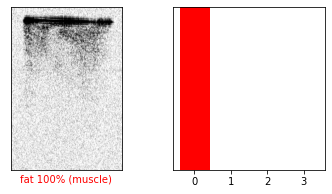

S2, idx=3712, pred=fat, actual=muscle


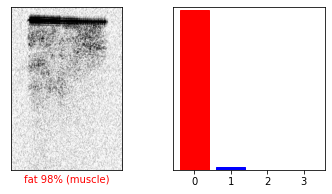

S2, idx=3718, pred=fat, actual=muscle


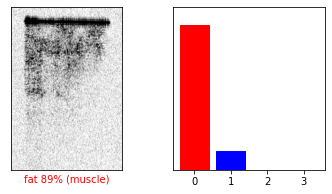

S2, idx=3719, pred=fat, actual=muscle


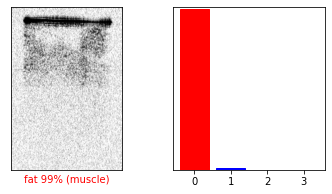

S2, idx=3720, pred=fat, actual=muscle


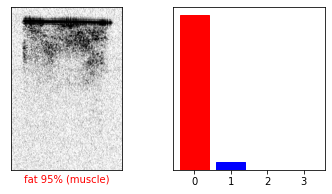

S2, idx=3729, pred=fat, actual=muscle


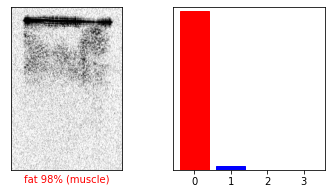

S2, idx=3730, pred=fat, actual=muscle


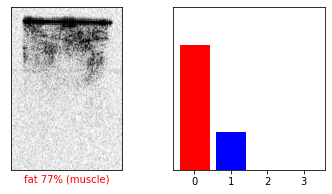

S2, idx=3731, pred=fat, actual=muscle


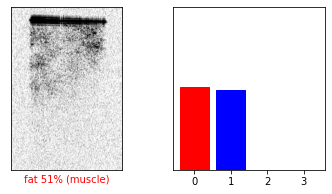

S2, idx=3737, pred=fat, actual=muscle


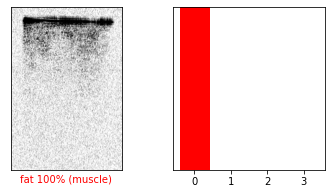

S2, idx=3741, pred=fat, actual=muscle


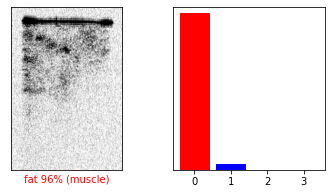

S2, idx=3749, pred=fat, actual=muscle


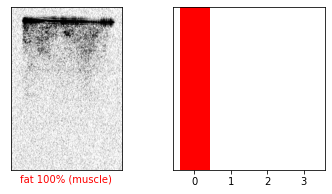

S2, idx=3751, pred=fat, actual=muscle


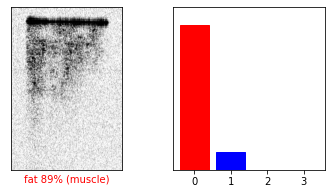

S2, idx=3752, pred=fat, actual=muscle


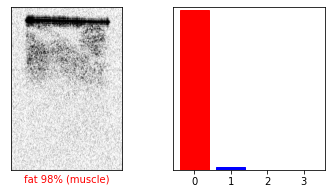

S2, idx=3760, pred=fat, actual=muscle


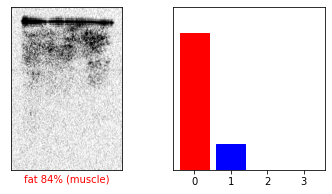

S2, idx=3761, pred=fat, actual=muscle


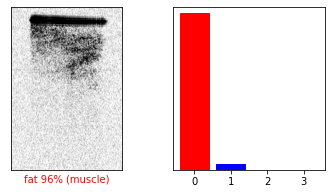

S2, idx=3763, pred=fat, actual=muscle


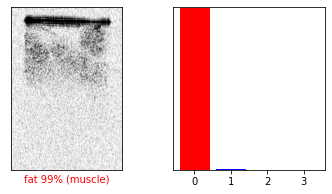

S2, idx=3772, pred=fat, actual=muscle


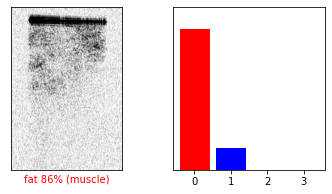

S2, idx=3774, pred=fat, actual=muscle


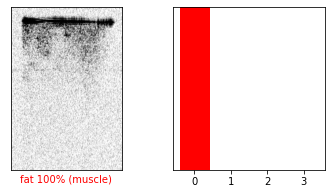

S2, idx=3781, pred=fat, actual=muscle


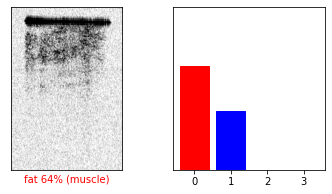

S2, idx=3784, pred=fat, actual=muscle


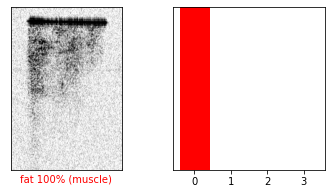

S2, idx=3785, pred=fat, actual=muscle


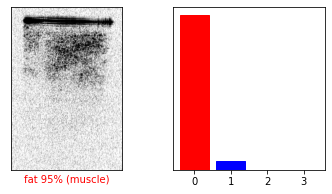

S2, idx=3793, pred=fat, actual=muscle


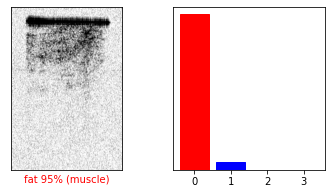

S2, idx=3795, pred=fat, actual=muscle


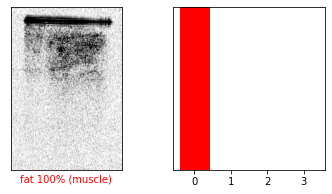

S2, idx=3804, pred=fat, actual=muscle


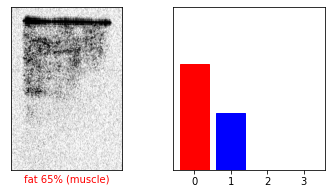

S2, idx=3809, pred=fat, actual=muscle


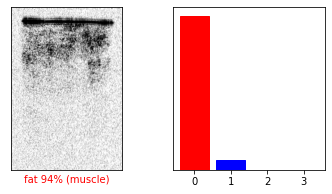

S2, idx=3816, pred=fat, actual=muscle


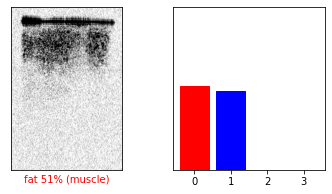

S2, idx=3822, pred=fat, actual=muscle


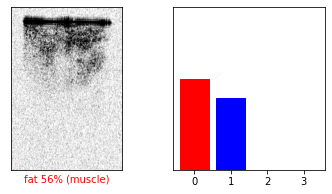

S2, idx=3823, pred=fat, actual=muscle


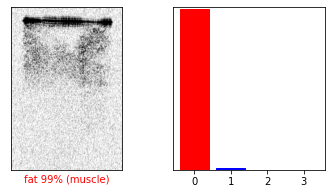

S2, idx=3831, pred=fat, actual=muscle


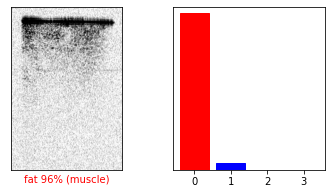

S2, idx=3832, pred=fat, actual=muscle


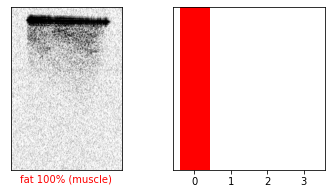

S2, idx=3835, pred=fat, actual=muscle


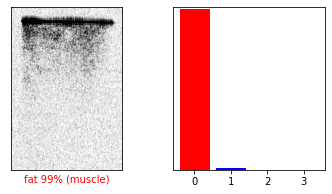

S2, idx=3839, pred=fat, actual=muscle


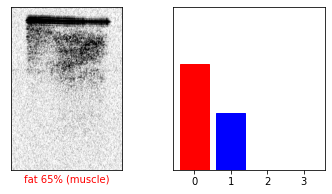

S2, idx=3845, pred=fat, actual=muscle


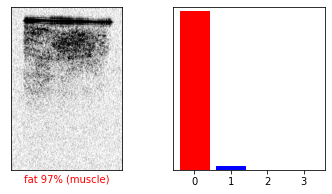

S2, idx=3846, pred=fat, actual=muscle


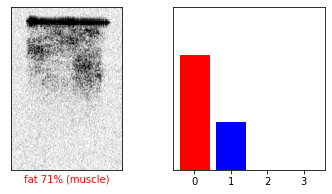

S2, idx=3850, pred=fat, actual=muscle


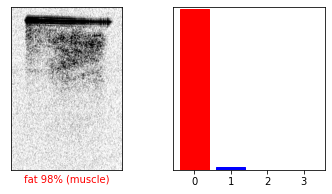

S2, idx=3856, pred=fat, actual=muscle


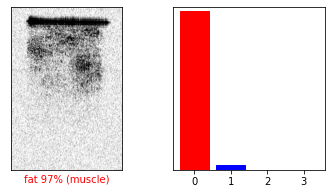

S2, idx=3857, pred=fat, actual=muscle


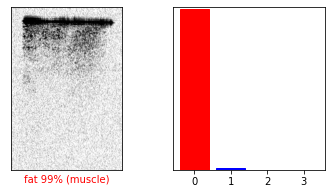

S2, idx=3858, pred=fat, actual=muscle


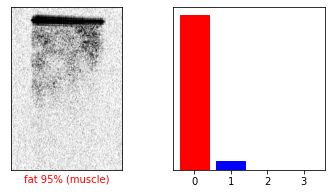

S2, idx=3860, pred=fat, actual=muscle


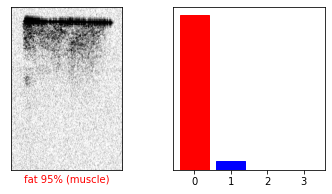

S2, idx=3861, pred=fat, actual=muscle


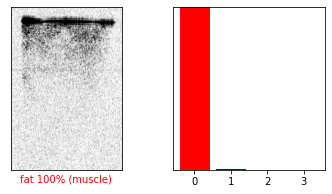

S2, idx=3862, pred=fat, actual=muscle


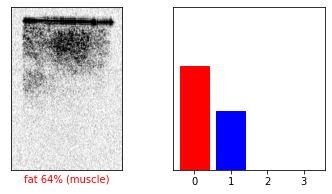

S2, idx=3868, pred=fat, actual=muscle


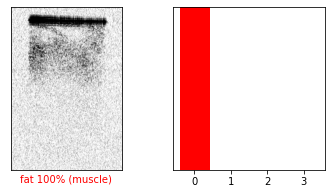

S2, idx=3869, pred=fat, actual=muscle


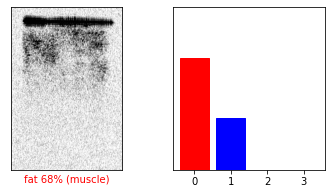

S2, idx=3872, pred=fat, actual=muscle


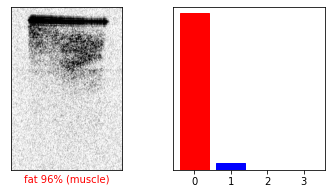

S2, idx=3874, pred=fat, actual=muscle


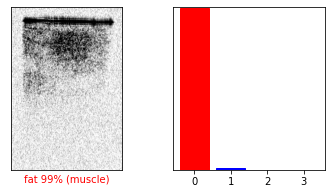

S2, idx=3875, pred=fat, actual=muscle


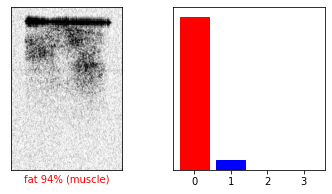

S2, idx=3883, pred=fat, actual=muscle


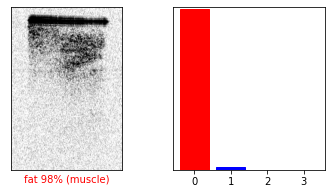

S2, idx=3899, pred=fat, actual=muscle


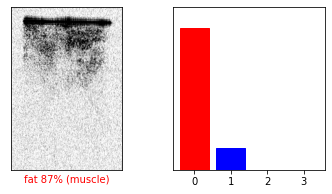

S2, idx=3904, pred=fat, actual=muscle


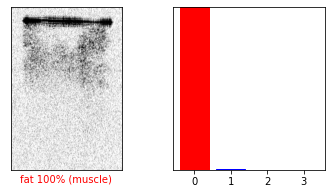

S2, idx=3913, pred=fat, actual=muscle


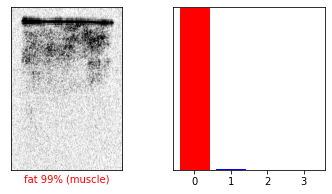

S2, idx=3917, pred=fat, actual=muscle


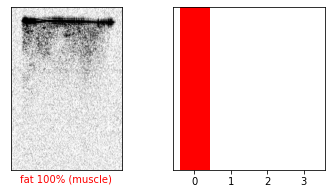

S2, idx=3921, pred=fat, actual=muscle


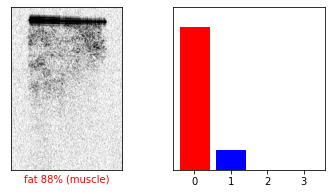

S2, idx=3927, pred=fat, actual=muscle


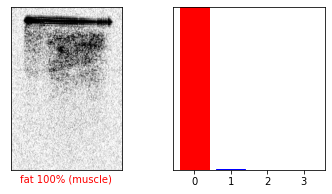

S2, idx=3933, pred=fat, actual=muscle


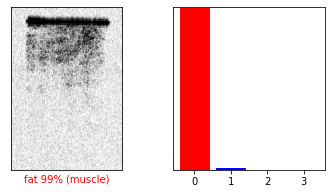

S2, idx=3937, pred=fat, actual=muscle


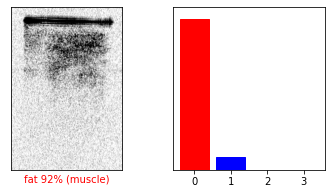

S2, idx=3938, pred=fat, actual=muscle


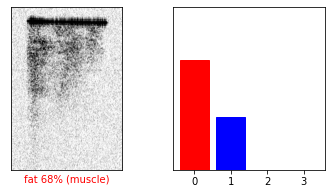

S2, idx=3948, pred=fat, actual=muscle


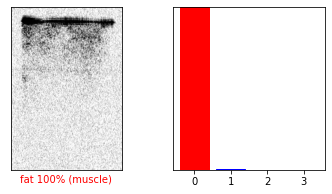

S2, idx=3949, pred=fat, actual=muscle


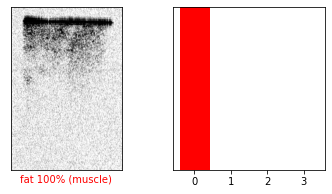

S2, idx=3950, pred=fat, actual=muscle


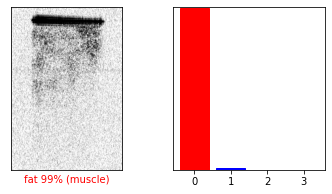

S2, idx=3951, pred=fat, actual=muscle


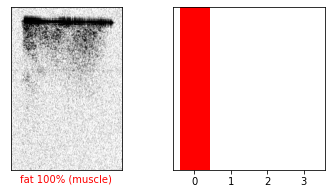

S2, idx=3954, pred=fat, actual=muscle


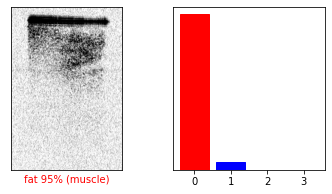

S2, idx=3955, pred=fat, actual=muscle


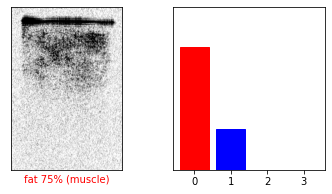

S2, idx=3957, pred=fat, actual=muscle


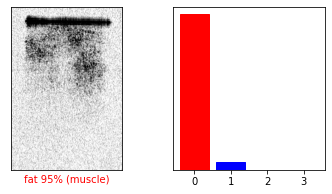

S2, idx=3965, pred=fat, actual=muscle


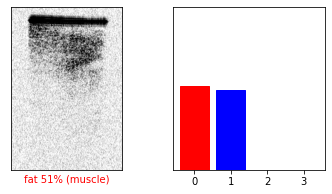

S2, idx=3969, pred=fat, actual=muscle


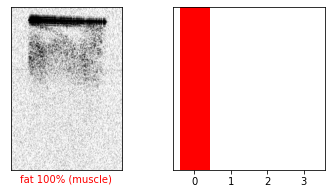

S2, idx=3975, pred=fat, actual=muscle


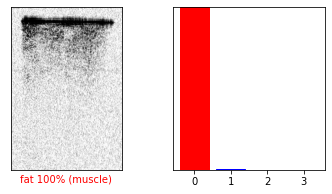

S2, idx=3977, pred=fat, actual=muscle


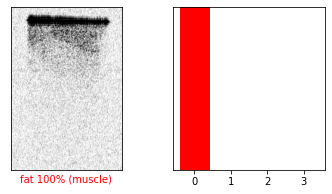

S2, idx=3978, pred=fat, actual=muscle


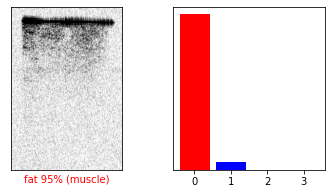

S2, idx=3982, pred=fat, actual=muscle


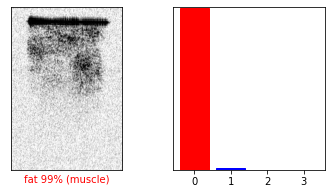

S2, idx=3983, pred=fat, actual=muscle


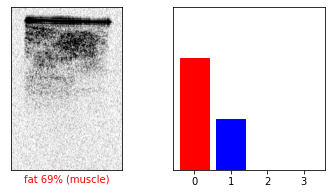

S2, idx=3984, pred=fat, actual=muscle


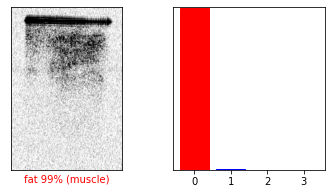

S2, idx=3992, pred=fat, actual=muscle


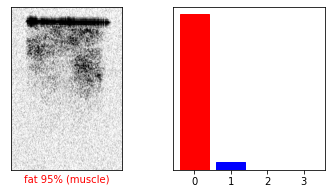

S2, idx=3993, pred=fat, actual=muscle


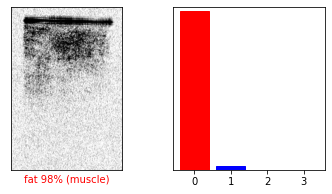

S2, idx=3995, pred=fat, actual=muscle


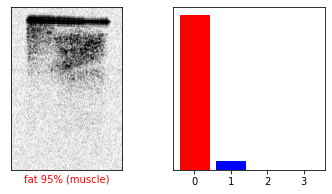

S3, idx=16, pred=fat, actual=muscle


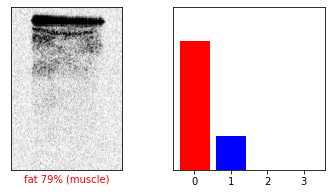

S3, idx=84, pred=fat, actual=muscle


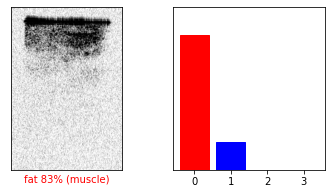

S3, idx=91, pred=fat, actual=muscle


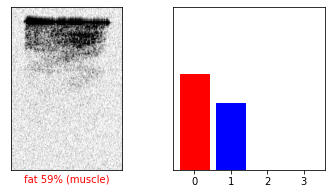

S3, idx=123, pred=fat, actual=muscle


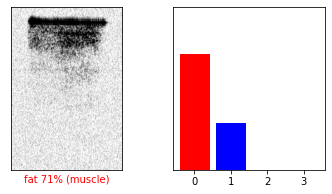

S3, idx=131, pred=fat, actual=muscle


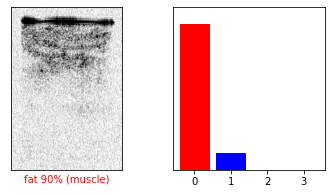

S3, idx=132, pred=fat, actual=muscle


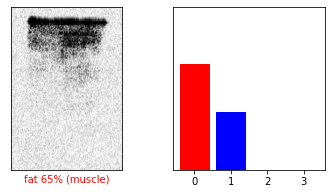

S3, idx=133, pred=fat, actual=muscle


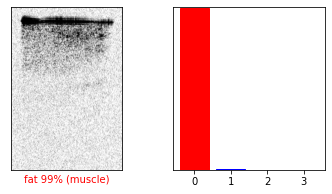

S3, idx=194, pred=fat, actual=muscle


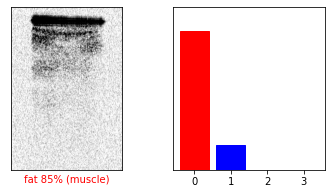

S3, idx=214, pred=fat, actual=muscle


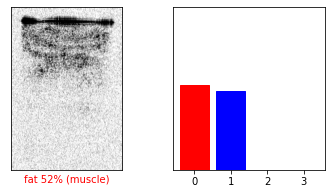

S3, idx=217, pred=fat, actual=muscle


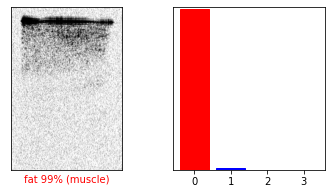

S3, idx=218, pred=fat, actual=muscle


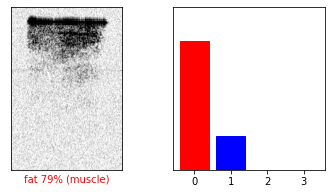

S3, idx=223, pred=fat, actual=muscle


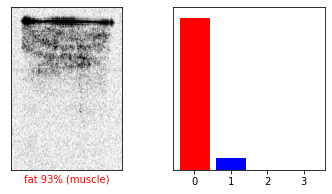

S3, idx=254, pred=fat, actual=muscle


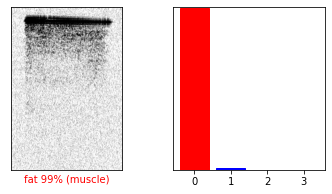

S3, idx=257, pred=fat, actual=muscle


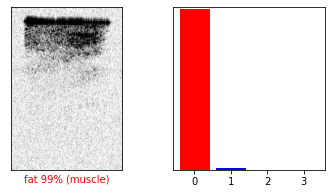

S3, idx=263, pred=fat, actual=muscle


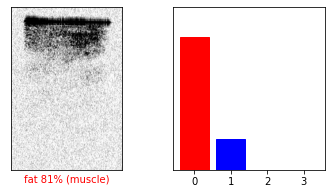

S3, idx=281, pred=fat, actual=muscle


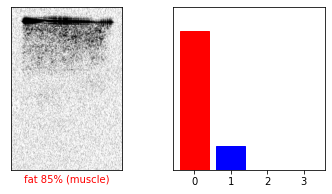

S3, idx=307, pred=fat, actual=muscle


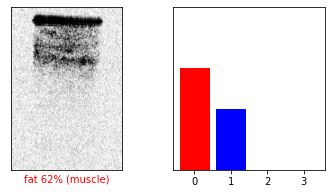

S3, idx=315, pred=fat, actual=muscle


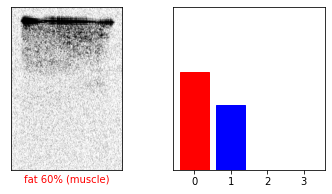

S3, idx=325, pred=fat, actual=muscle


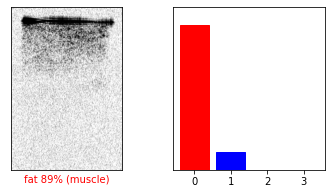

S3, idx=329, pred=fat, actual=muscle


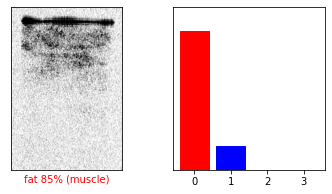

S3, idx=368, pred=fat, actual=muscle


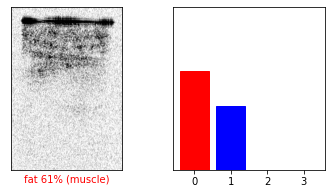

S3, idx=395, pred=fat, actual=muscle


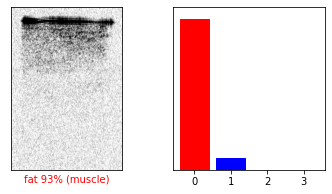

S3, idx=406, pred=fat, actual=muscle


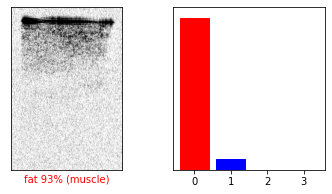

S3, idx=411, pred=fat, actual=muscle


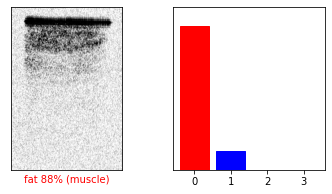

S3, idx=434, pred=fat, actual=muscle


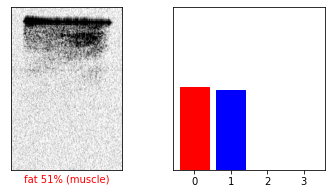

S3, idx=435, pred=fat, actual=muscle


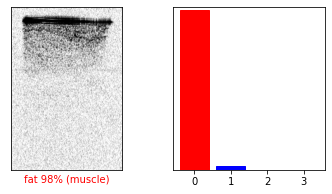

S3, idx=445, pred=fat, actual=muscle


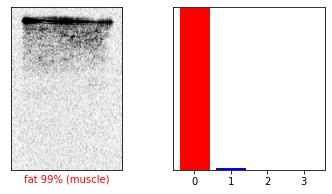

S3, idx=469, pred=fat, actual=muscle


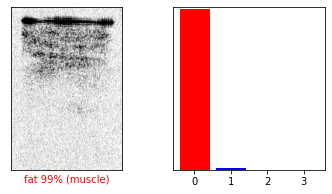

S3, idx=506, pred=fat, actual=muscle


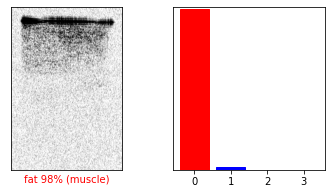

S3, idx=514, pred=fat, actual=muscle


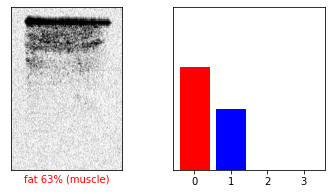

S3, idx=517, pred=fat, actual=muscle


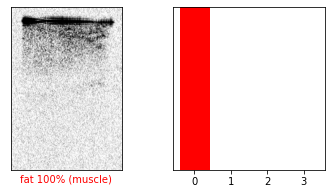

S3, idx=533, pred=fat, actual=muscle


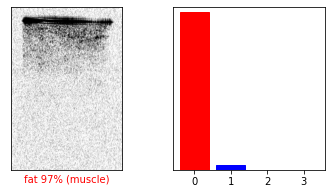

S3, idx=538, pred=fat, actual=muscle


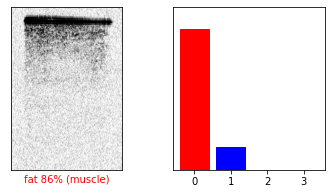

S3, idx=545, pred=fat, actual=muscle


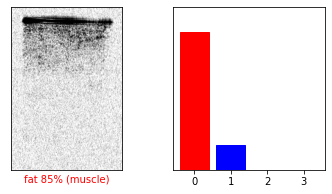

S3, idx=547, pred=fat, actual=muscle


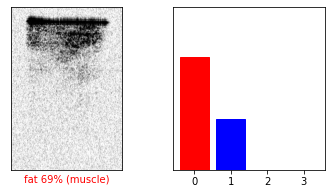

S3, idx=563, pred=fat, actual=muscle


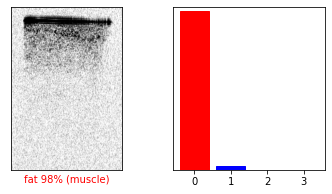

S3, idx=564, pred=fat, actual=muscle


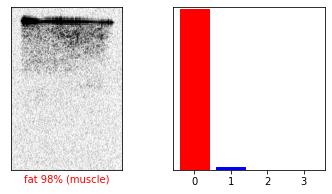

S3, idx=573, pred=fat, actual=muscle


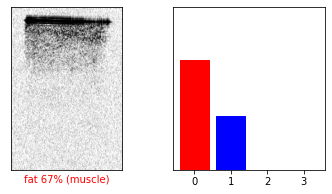

S3, idx=625, pred=fat, actual=muscle


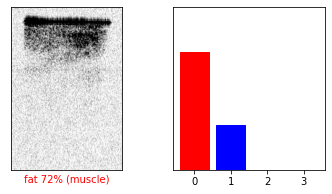

S3, idx=626, pred=fat, actual=muscle


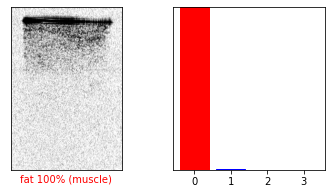

S3, idx=632, pred=fat, actual=muscle


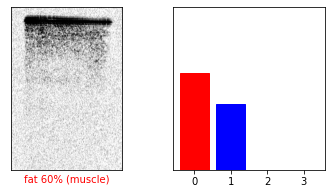

S3, idx=637, pred=fat, actual=muscle


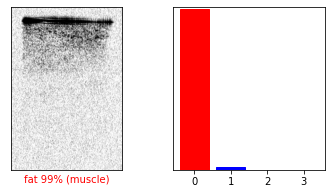

S3, idx=649, pred=fat, actual=muscle


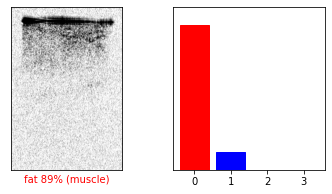

S3, idx=659, pred=fat, actual=muscle


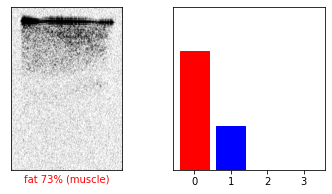

S3, idx=683, pred=fat, actual=muscle


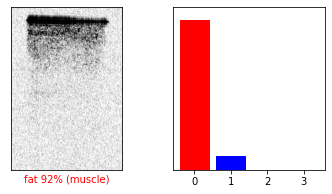

S3, idx=695, pred=fat, actual=muscle


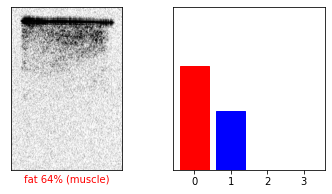

S3, idx=710, pred=fat, actual=muscle


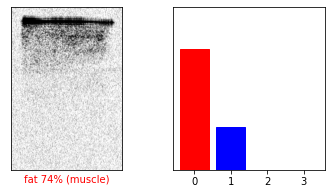

S3, idx=711, pred=fat, actual=muscle


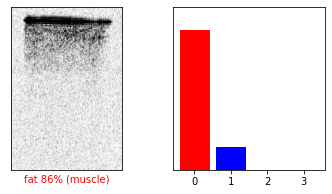

S3, idx=722, pred=fat, actual=muscle


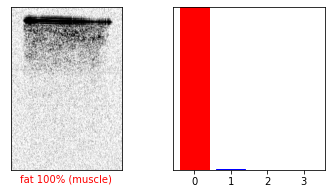

S3, idx=732, pred=fat, actual=muscle


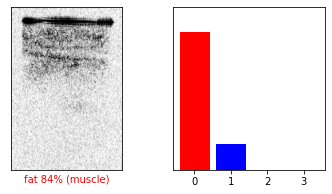

S3, idx=740, pred=fat, actual=muscle


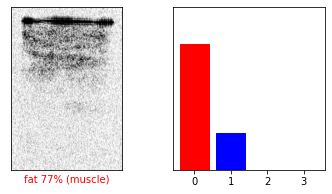

S3, idx=744, pred=fat, actual=muscle


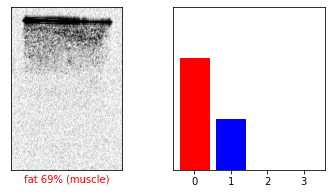

S3, idx=797, pred=fat, actual=muscle


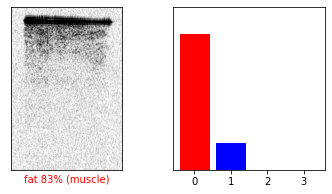

S3, idx=812, pred=fat, actual=muscle


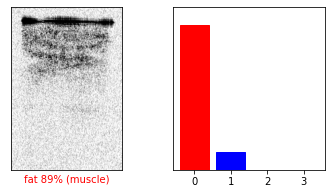

S3, idx=821, pred=fat, actual=muscle


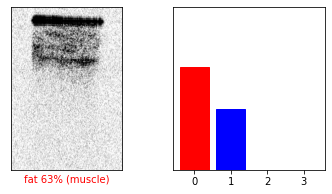

S3, idx=842, pred=fat, actual=muscle


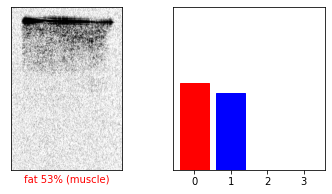

S3, idx=904, pred=fat, actual=muscle


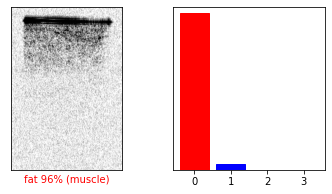

S3, idx=933, pred=fat, actual=muscle


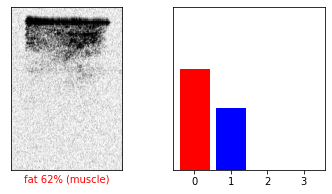

S3, idx=934, pred=fat, actual=muscle


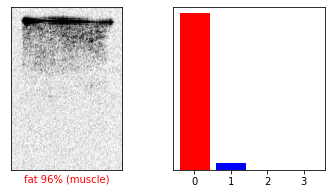

S3, idx=963, pred=fat, actual=muscle


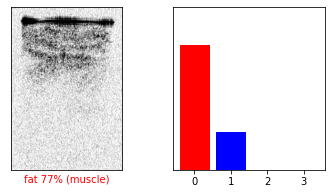

S3, idx=973, pred=fat, actual=muscle


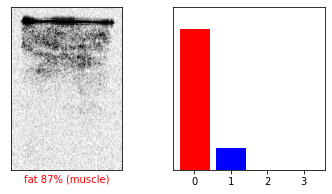

S3, idx=2003, pred=muscle, actual=fat


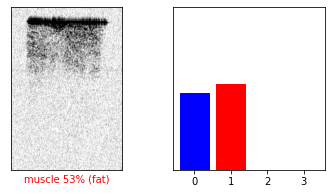

S3, idx=2051, pred=muscle, actual=fat


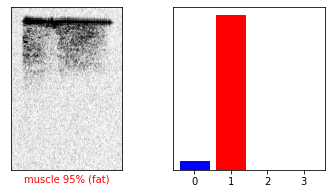

S3, idx=2052, pred=muscle, actual=fat


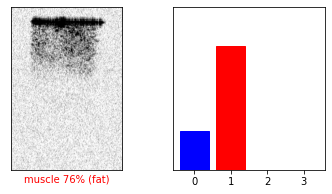

S3, idx=2070, pred=muscle, actual=fat


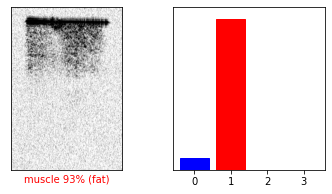

S3, idx=2094, pred=muscle, actual=fat


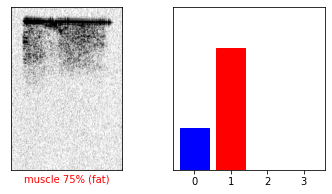

S3, idx=2108, pred=muscle, actual=fat


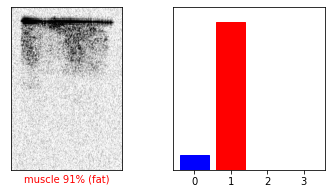

S3, idx=2117, pred=muscle, actual=fat


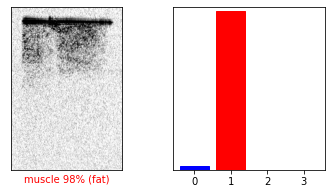

S3, idx=2131, pred=muscle, actual=fat


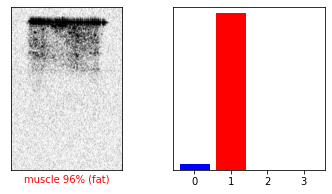

S3, idx=2152, pred=muscle, actual=fat


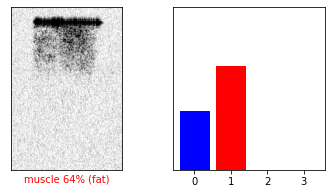

S3, idx=2191, pred=muscle, actual=fat


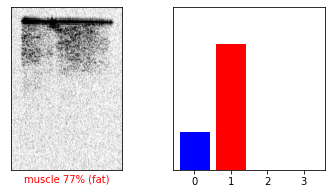

S3, idx=2211, pred=muscle, actual=fat


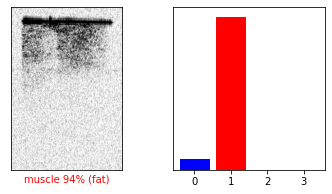

S3, idx=2227, pred=muscle, actual=fat


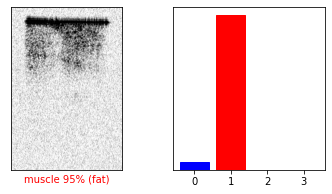

S3, idx=2242, pred=muscle, actual=fat


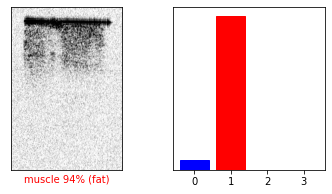

S3, idx=2271, pred=muscle, actual=fat


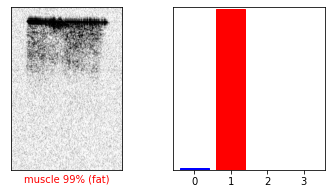

S3, idx=2291, pred=muscle, actual=fat


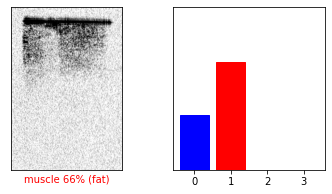

S3, idx=2312, pred=muscle, actual=fat


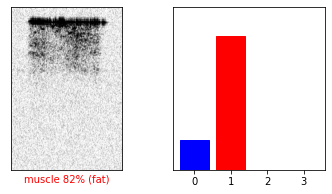

S3, idx=2328, pred=muscle, actual=fat


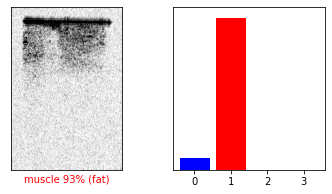

S3, idx=2332, pred=muscle, actual=fat


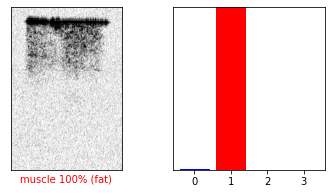

S3, idx=2351, pred=muscle, actual=fat


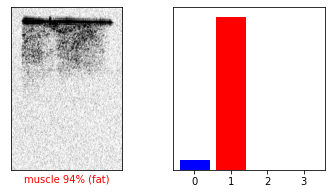

S3, idx=2375, pred=muscle, actual=fat


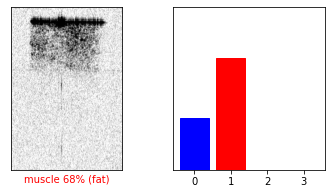

S3, idx=2376, pred=muscle, actual=fat


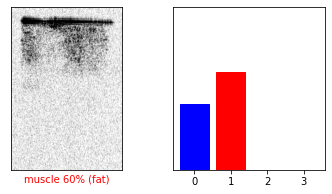

S3, idx=2400, pred=muscle, actual=fat


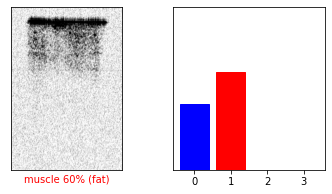

S3, idx=2453, pred=muscle, actual=fat


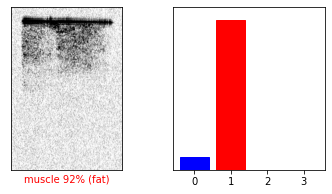

S3, idx=2456, pred=muscle, actual=fat


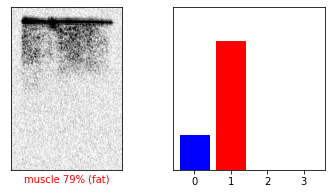

S3, idx=2471, pred=muscle, actual=fat


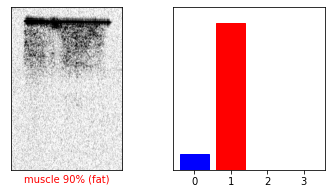

S3, idx=2495, pred=muscle, actual=fat


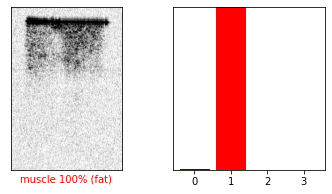

S3, idx=2518, pred=muscle, actual=fat


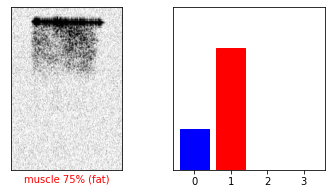

S3, idx=2570, pred=muscle, actual=fat


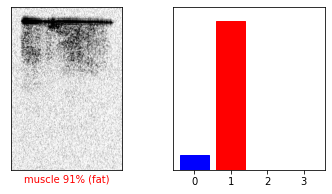

S3, idx=2586, pred=muscle, actual=fat


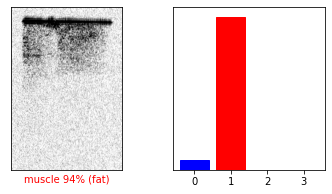

S3, idx=2594, pred=muscle, actual=fat


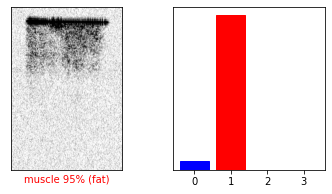

S3, idx=2620, pred=muscle, actual=fat


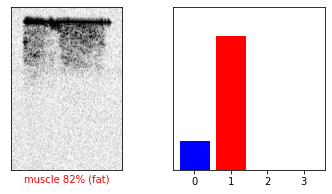

S3, idx=2645, pred=muscle, actual=fat


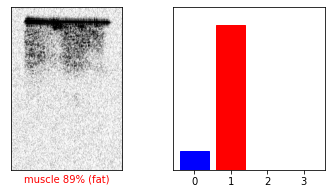

S3, idx=2662, pred=muscle, actual=fat


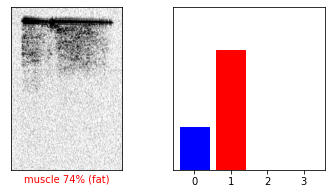

S3, idx=2663, pred=muscle, actual=fat


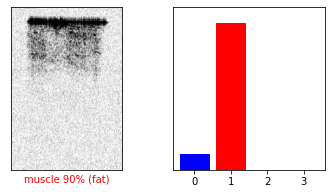

S3, idx=2700, pred=muscle, actual=fat


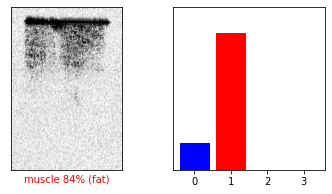

S3, idx=2727, pred=muscle, actual=fat


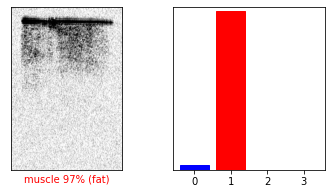

S3, idx=2744, pred=muscle, actual=fat


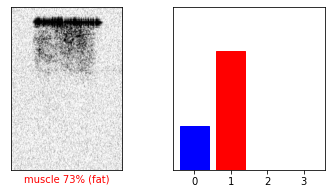

S3, idx=2745, pred=muscle, actual=fat


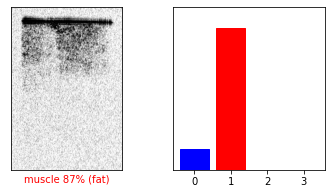

S3, idx=2776, pred=muscle, actual=fat


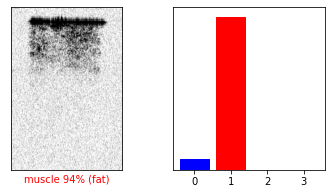

S3, idx=2816, pred=muscle, actual=fat


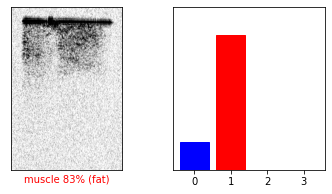

S3, idx=2834, pred=muscle, actual=fat


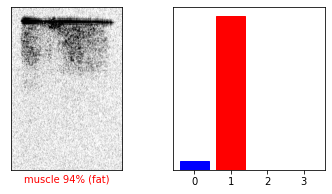

S3, idx=2857, pred=muscle, actual=fat


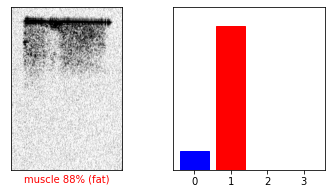

S3, idx=2860, pred=muscle, actual=fat


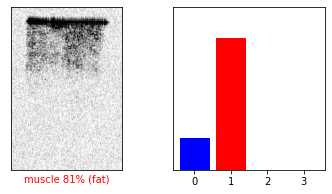

S3, idx=2868, pred=muscle, actual=fat


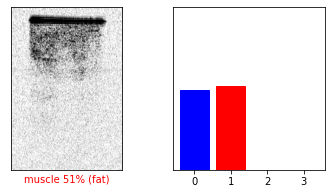

S3, idx=2882, pred=muscle, actual=fat


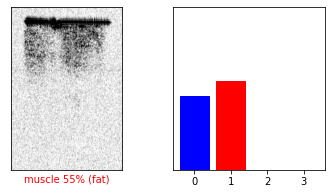

S3, idx=2915, pred=muscle, actual=fat


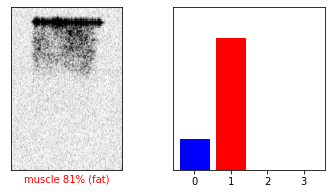

S3, idx=2926, pred=muscle, actual=fat


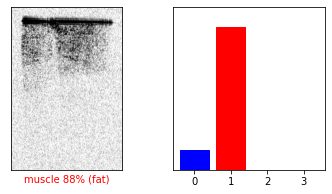

S3, idx=2942, pred=muscle, actual=fat


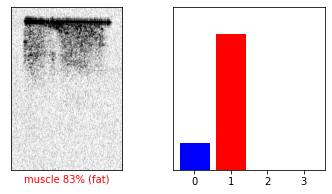

S3, idx=2969, pred=muscle, actual=fat


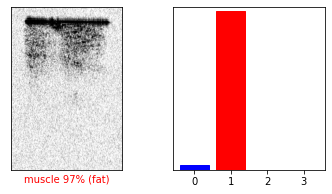

S3, idx=2982, pred=muscle, actual=fat


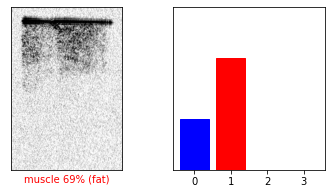

S3, idx=2987, pred=muscle, actual=fat


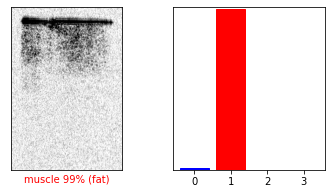

S4, idx=19, pred=muscle, actual=fat


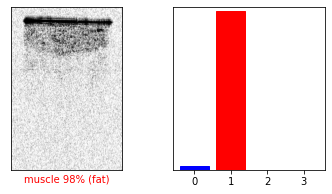

S4, idx=56, pred=muscle, actual=fat


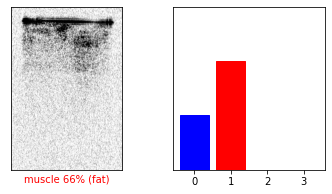

S4, idx=63, pred=muscle, actual=fat


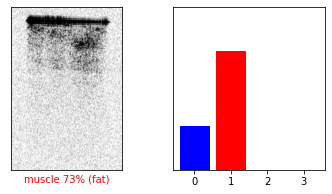

S4, idx=75, pred=muscle, actual=fat


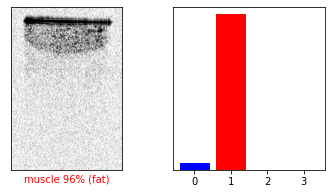

S4, idx=76, pred=muscle, actual=fat


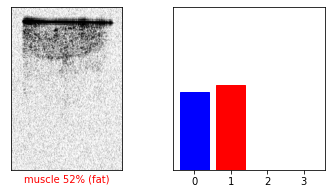

S4, idx=84, pred=muscle, actual=fat


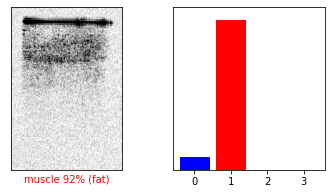

S4, idx=91, pred=muscle, actual=fat


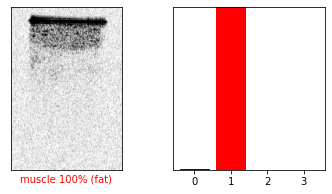

S4, idx=122, pred=muscle, actual=fat


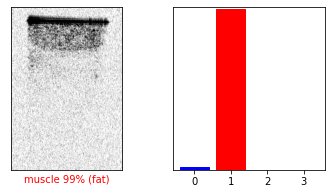

S4, idx=132, pred=muscle, actual=fat


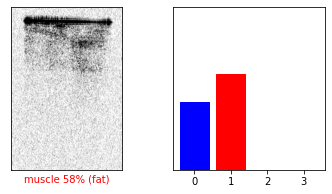

S4, idx=133, pred=muscle, actual=fat


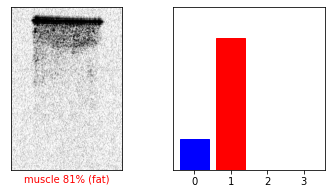

S4, idx=138, pred=muscle, actual=fat


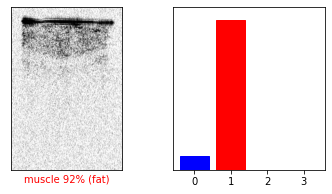

S4, idx=189, pred=muscle, actual=fat


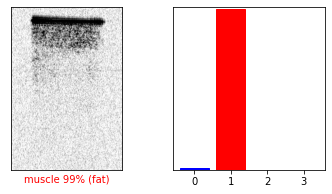

S4, idx=191, pred=muscle, actual=fat


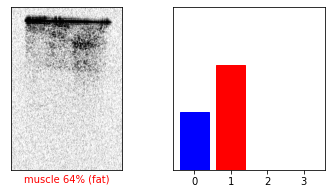

S4, idx=201, pred=muscle, actual=fat


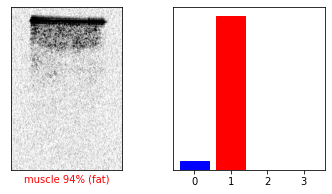

S4, idx=209, pred=muscle, actual=fat


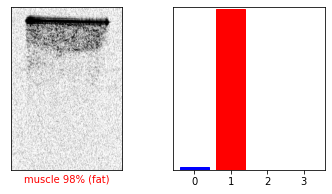

S4, idx=210, pred=muscle, actual=fat


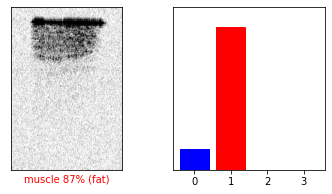

S4, idx=218, pred=muscle, actual=fat


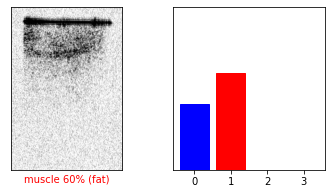

S4, idx=231, pred=muscle, actual=fat


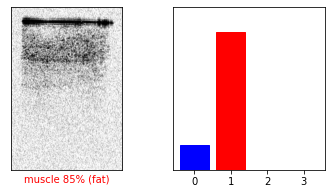

S4, idx=249, pred=muscle, actual=fat


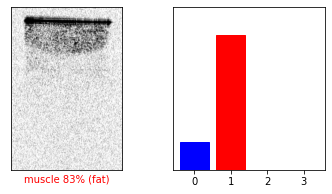

S4, idx=252, pred=muscle, actual=fat


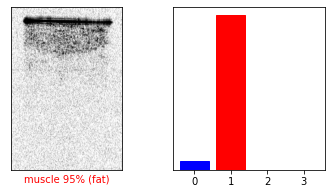

S4, idx=258, pred=muscle, actual=fat


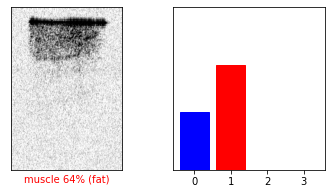

S4, idx=295, pred=muscle, actual=fat


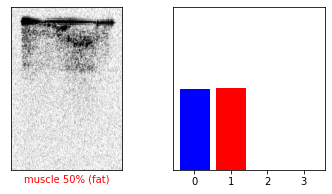

S4, idx=296, pred=muscle, actual=fat


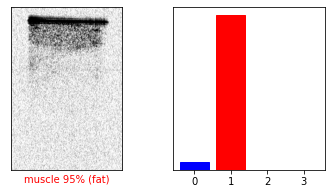

S4, idx=297, pred=muscle, actual=fat


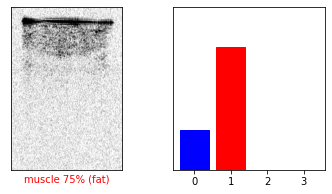

S4, idx=311, pred=muscle, actual=fat


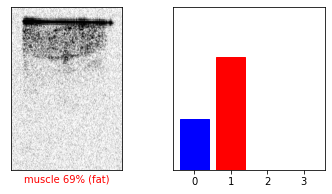

S4, idx=330, pred=muscle, actual=fat


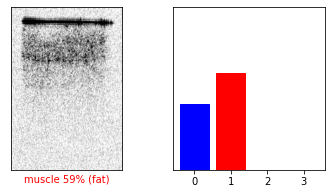

S4, idx=335, pred=muscle, actual=fat


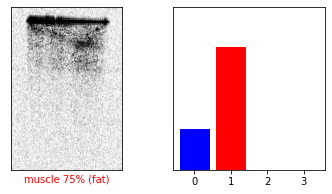

S4, idx=336, pred=muscle, actual=fat


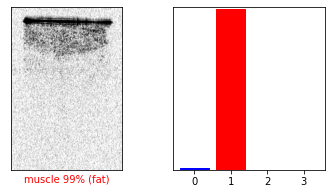

S4, idx=350, pred=muscle, actual=fat


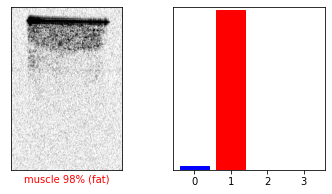

S4, idx=353, pred=muscle, actual=fat


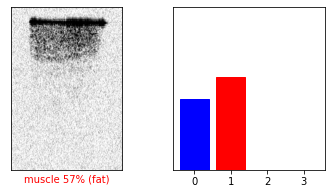

S4, idx=360, pred=muscle, actual=fat


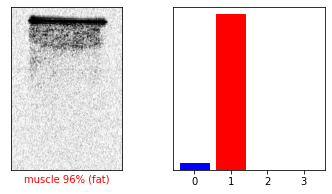

S4, idx=374, pred=muscle, actual=fat


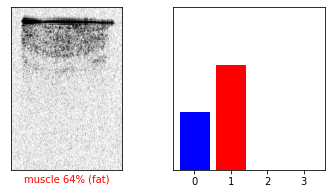

S4, idx=438, pred=muscle, actual=fat


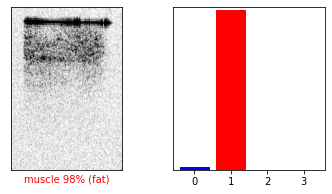

S4, idx=439, pred=muscle, actual=fat


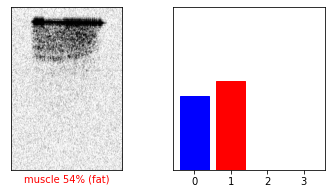

S4, idx=444, pred=muscle, actual=fat


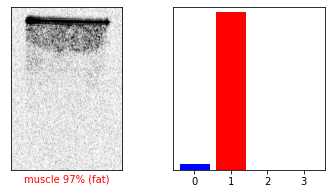

S4, idx=459, pred=muscle, actual=fat


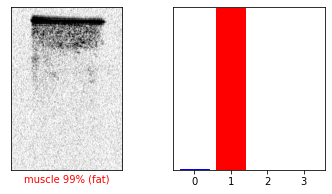

S4, idx=461, pred=muscle, actual=fat


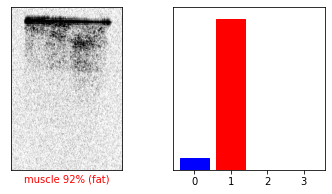

S4, idx=463, pred=muscle, actual=fat


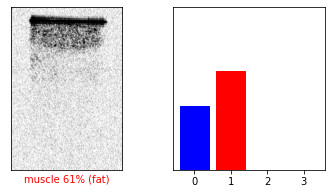

S4, idx=482, pred=muscle, actual=fat


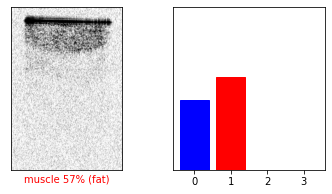

S4, idx=497, pred=muscle, actual=fat


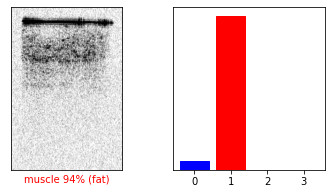

S4, idx=523, pred=muscle, actual=fat


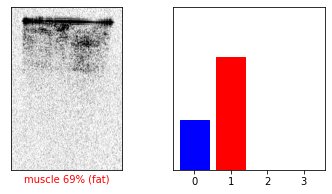

S4, idx=565, pred=muscle, actual=fat


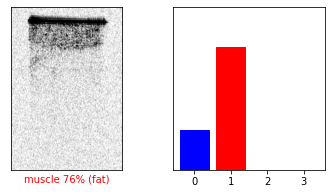

S4, idx=579, pred=muscle, actual=fat


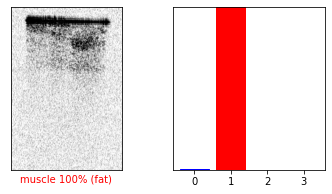

S4, idx=580, pred=muscle, actual=fat


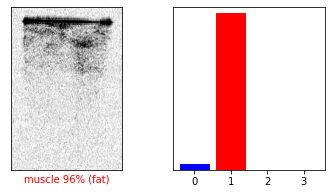

S4, idx=589, pred=muscle, actual=fat


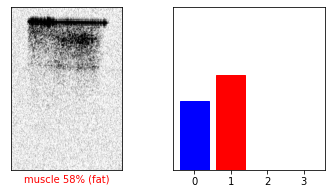

S4, idx=597, pred=muscle, actual=fat


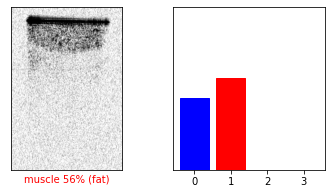

S4, idx=603, pred=muscle, actual=fat


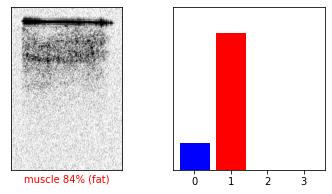

S4, idx=609, pred=muscle, actual=fat


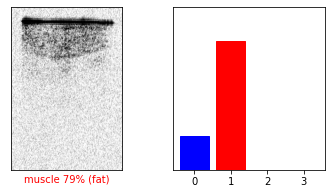

S4, idx=616, pred=muscle, actual=fat


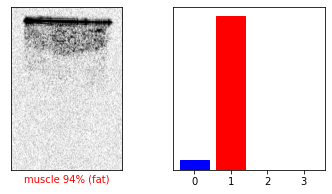

S4, idx=661, pred=muscle, actual=fat


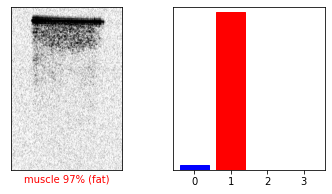

S4, idx=663, pred=muscle, actual=fat


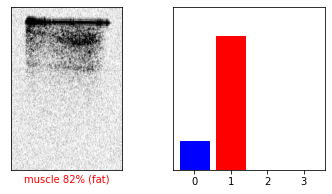

S4, idx=677, pred=muscle, actual=fat


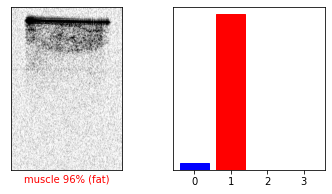

S4, idx=715, pred=muscle, actual=fat


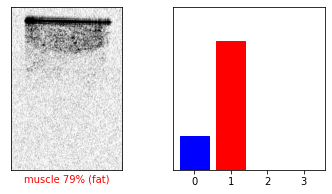

S4, idx=727, pred=muscle, actual=fat


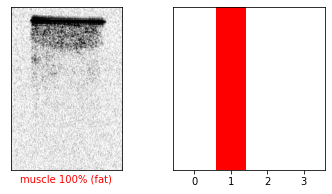

S4, idx=733, pred=muscle, actual=fat


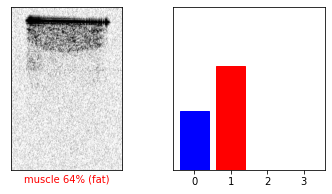

S4, idx=736, pred=muscle, actual=fat


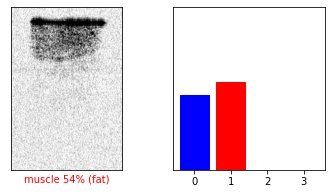

S4, idx=754, pred=muscle, actual=fat


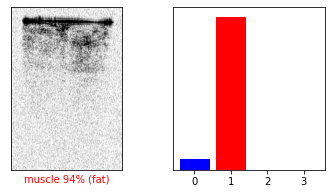

S4, idx=799, pred=muscle, actual=fat


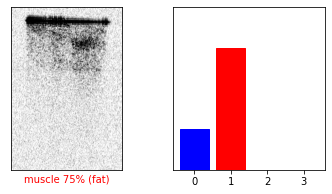

S4, idx=829, pred=muscle, actual=fat


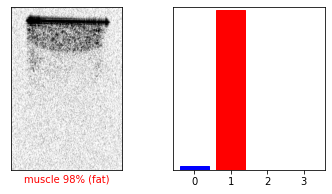

S4, idx=830, pred=muscle, actual=fat


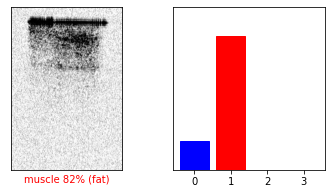

S4, idx=843, pred=muscle, actual=fat


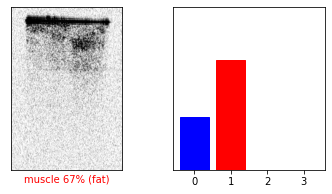

S4, idx=853, pred=muscle, actual=fat


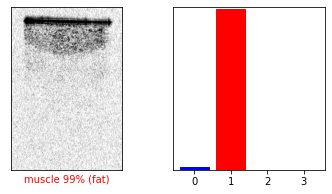

S4, idx=869, pred=muscle, actual=fat


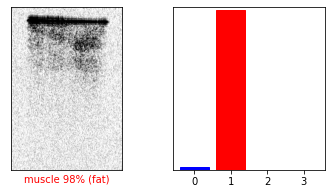

S4, idx=909, pred=muscle, actual=fat


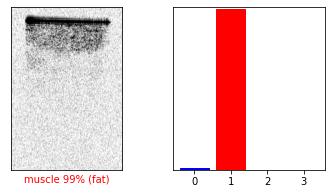

S4, idx=925, pred=muscle, actual=fat


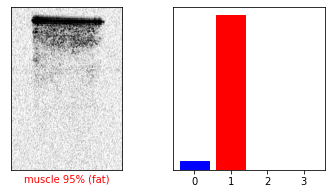

S4, idx=947, pred=muscle, actual=fat


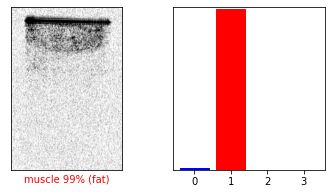

S4, idx=959, pred=muscle, actual=fat


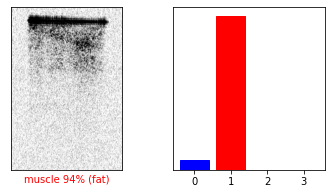

S4, idx=974, pred=muscle, actual=fat


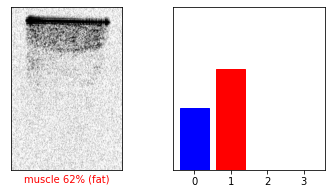

S4, idx=992, pred=muscle, actual=fat


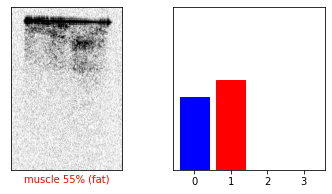

S4, idx=995, pred=muscle, actual=fat


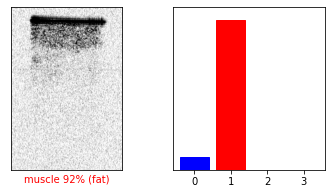

S4, idx=1029, pred=fat, actual=muscle


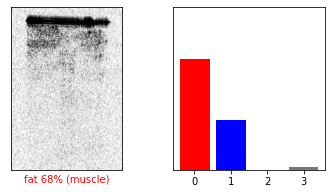

S4, idx=1069, pred=fat, actual=muscle


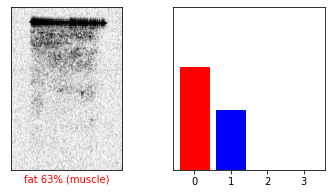

S4, idx=1303, pred=fat, actual=muscle


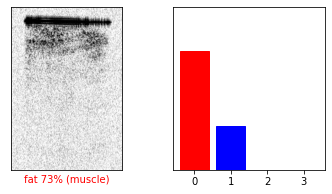

S4, idx=1311, pred=fat, actual=muscle


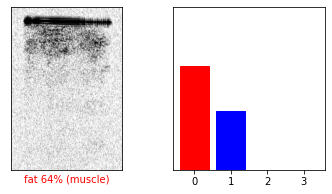

S4, idx=1343, pred=fat, actual=muscle


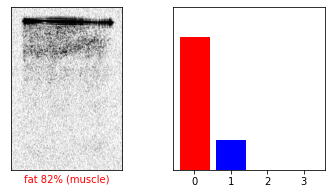

S4, idx=1434, pred=fat, actual=muscle


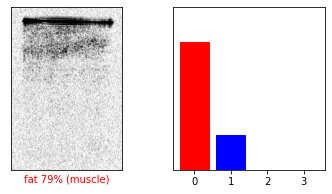

S4, idx=1490, pred=fat, actual=muscle


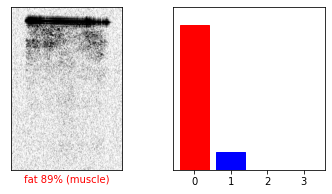

S4, idx=1662, pred=fat, actual=muscle


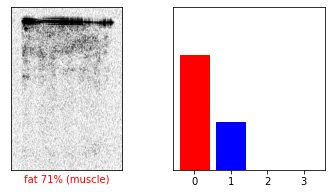

S4, idx=1780, pred=fat, actual=muscle


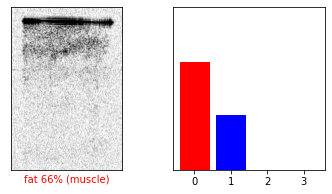

S4, idx=1789, pred=fat, actual=muscle


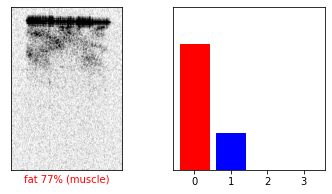

S4, idx=1828, pred=fat, actual=muscle


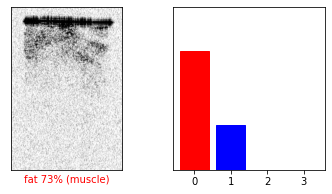

S5, idx=89, pred=fat, actual=muscle


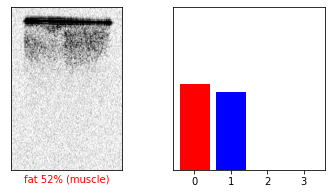

S5, idx=98, pred=fat, actual=muscle


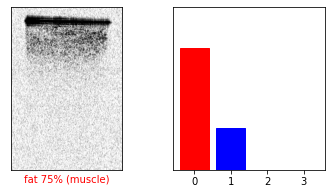

S5, idx=115, pred=fat, actual=muscle


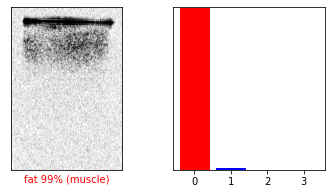

S5, idx=125, pred=fat, actual=muscle


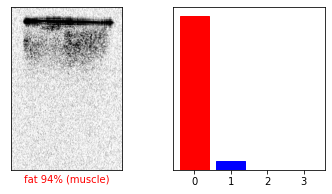

S5, idx=219, pred=fat, actual=muscle


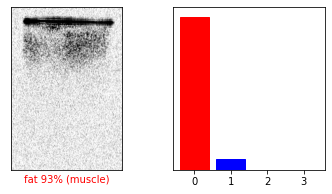

S5, idx=229, pred=fat, actual=muscle


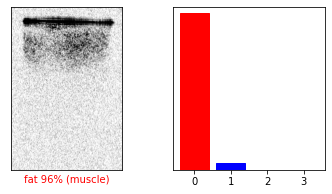

S5, idx=254, pred=fat, actual=muscle


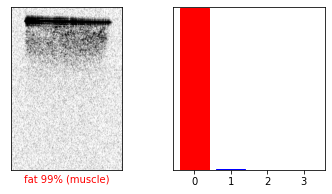

S5, idx=263, pred=fat, actual=muscle


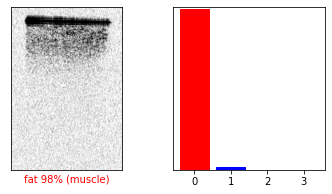

S5, idx=264, pred=fat, actual=muscle


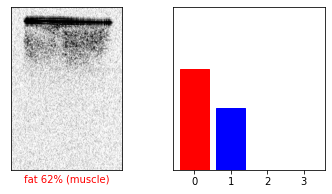

S5, idx=285, pred=fat, actual=muscle


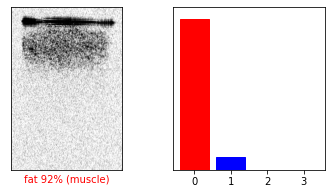

S5, idx=296, pred=fat, actual=muscle


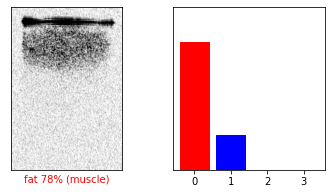

S5, idx=308, pred=fat, actual=muscle


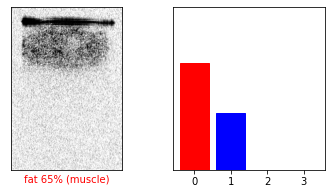

S5, idx=408, pred=fat, actual=muscle


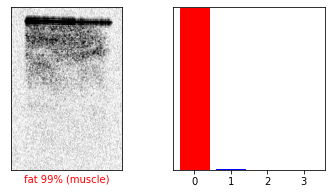

S5, idx=429, pred=fat, actual=muscle


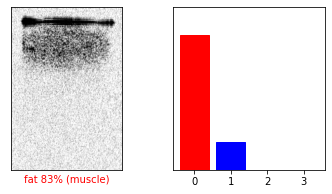

S5, idx=440, pred=fat, actual=muscle


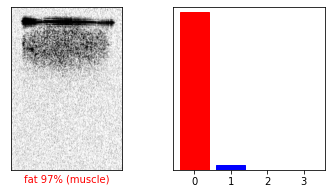

S5, idx=540, pred=fat, actual=muscle


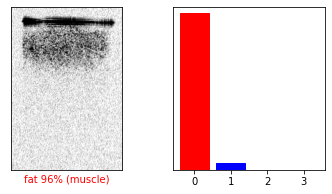

S5, idx=549, pred=fat, actual=muscle


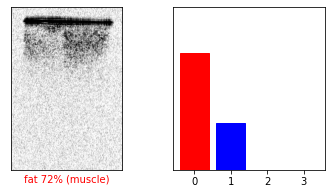

S5, idx=630, pred=fat, actual=muscle


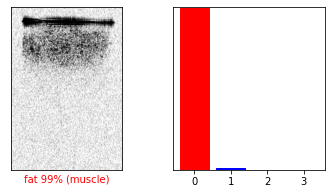

S5, idx=655, pred=fat, actual=muscle


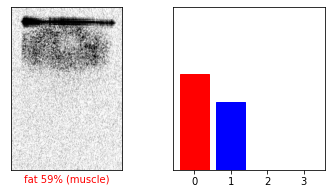

S5, idx=797, pred=fat, actual=muscle


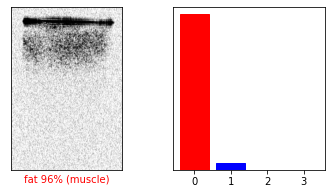

S5, idx=805, pred=fat, actual=muscle


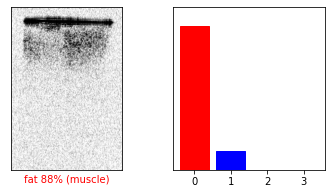

S5, idx=810, pred=fat, actual=muscle


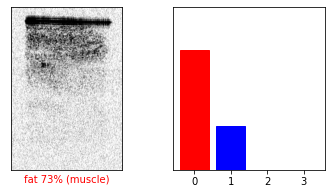

S5, idx=841, pred=fat, actual=muscle


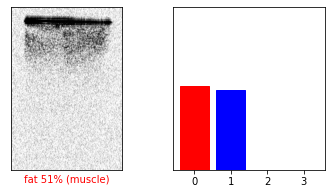

S5, idx=849, pred=fat, actual=muscle


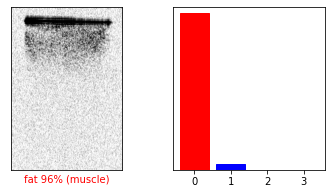

S5, idx=933, pred=fat, actual=muscle


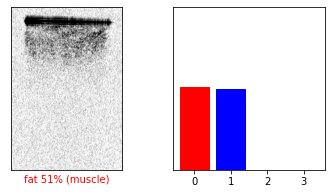

S5, idx=940, pred=fat, actual=muscle


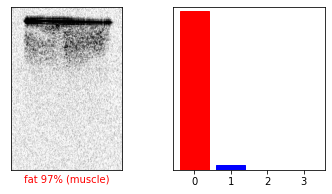

S5, idx=969, pred=fat, actual=muscle


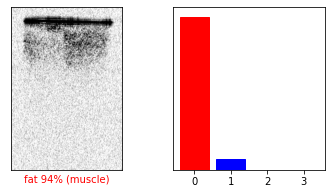

S5, idx=996, pred=fat, actual=muscle


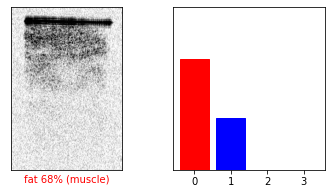

S5, idx=3102, pred=muscle, actual=fat


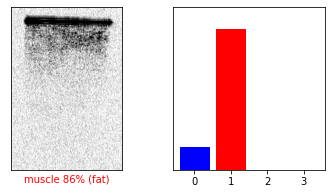

S5, idx=3140, pred=muscle, actual=fat


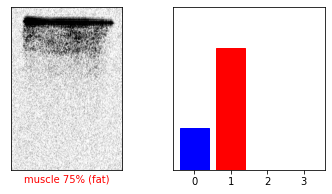

S5, idx=3339, pred=muscle, actual=fat


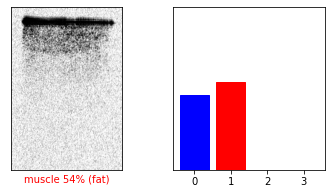

S5, idx=3376, pred=muscle, actual=fat


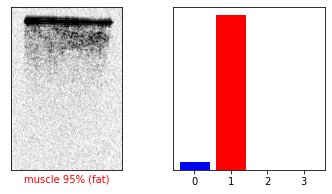

S5, idx=3382, pred=muscle, actual=fat


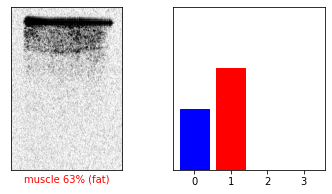

S5, idx=3408, pred=muscle, actual=fat


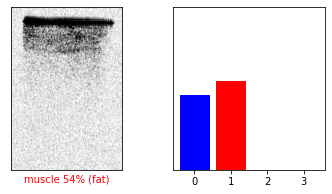

S5, idx=3432, pred=muscle, actual=fat


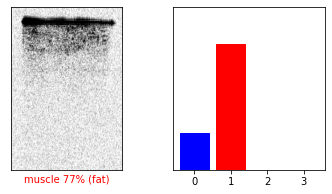

S5, idx=3458, pred=muscle, actual=fat


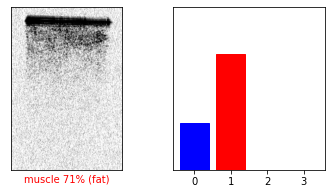

S5, idx=3497, pred=muscle, actual=fat


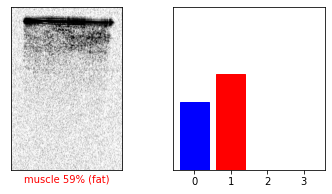

S5, idx=3506, pred=muscle, actual=fat


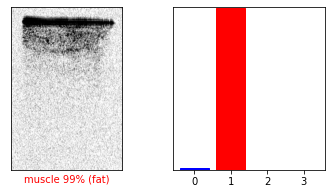

S5, idx=3622, pred=muscle, actual=fat


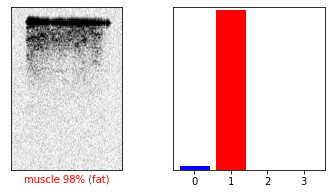

S5, idx=3774, pred=muscle, actual=fat


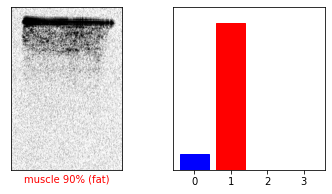

S5, idx=3779, pred=muscle, actual=fat


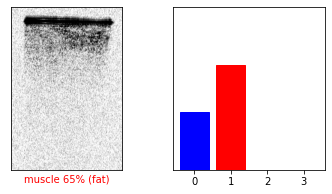

S5, idx=3810, pred=muscle, actual=fat


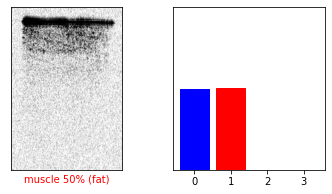

S5, idx=3862, pred=muscle, actual=fat


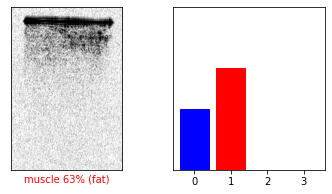

S5, idx=3922, pred=muscle, actual=fat


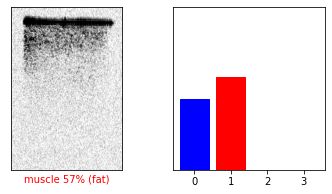

S5, idx=3930, pred=muscle, actual=fat


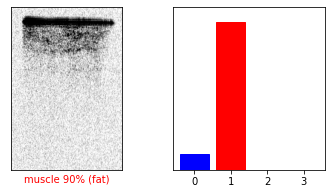

S5, idx=3942, pred=muscle, actual=fat


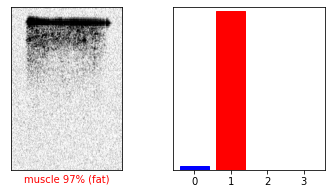

S5, idx=3950, pred=muscle, actual=fat


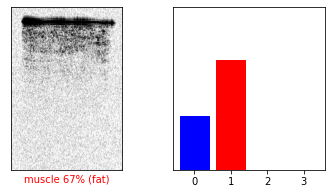

S5, idx=3985, pred=muscle, actual=fat


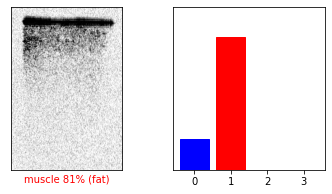

S6, idx=2460, pred=fat, actual=muscle


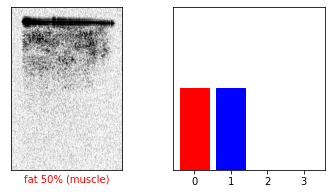

S6, idx=2470, pred=fat, actual=muscle


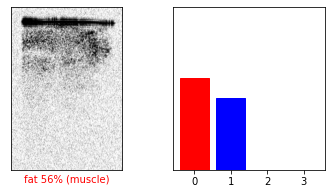

S6, idx=2568, pred=fat, actual=muscle


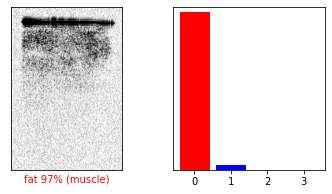

S6, idx=2577, pred=fat, actual=muscle


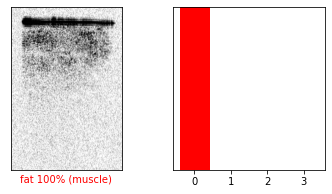

S6, idx=2712, pred=fat, actual=muscle


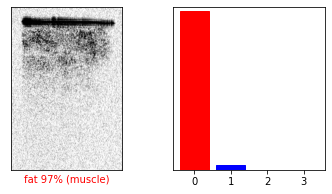

S6, idx=2721, pred=fat, actual=muscle


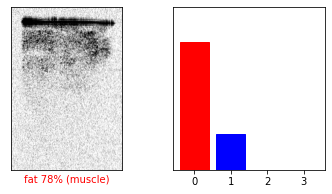

S6, idx=2965, pred=fat, actual=muscle


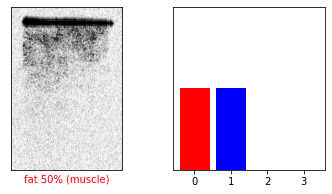

S7, idx=112, pred=fat, actual=muscle


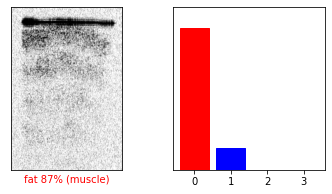

S7, idx=178, pred=fat, actual=muscle


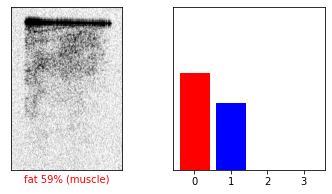

S7, idx=291, pred=fat, actual=muscle


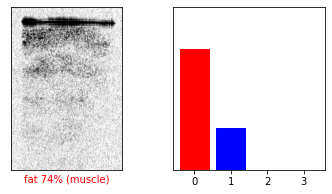

S7, idx=511, pred=fat, actual=muscle


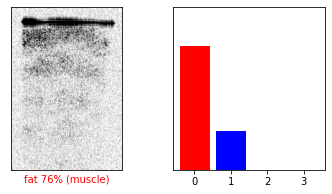

S7, idx=665, pred=fat, actual=muscle


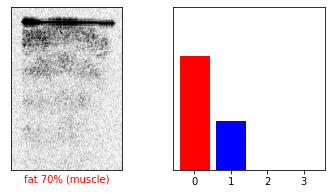

S7, idx=777, pred=fat, actual=muscle


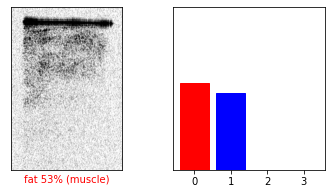

S7, idx=914, pred=fat, actual=muscle


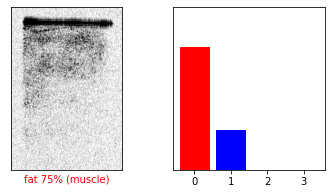

S7, idx=1433, pred=fat, actual=intestine


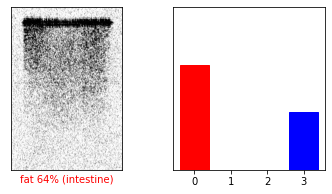

S8, idx=2032, pred=fat, actual=muscle


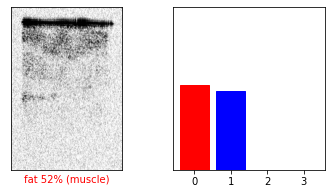

S8, idx=2063, pred=fat, actual=muscle


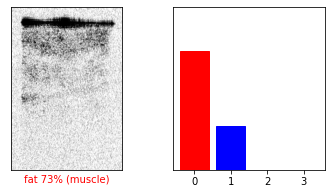

S8, idx=2121, pred=fat, actual=muscle


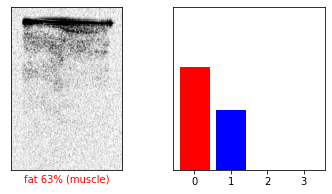

S8, idx=2156, pred=fat, actual=muscle


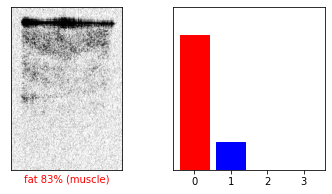

S8, idx=2189, pred=fat, actual=muscle


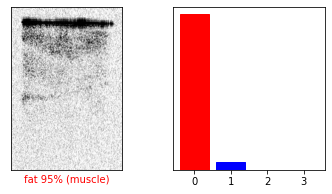

S8, idx=2231, pred=fat, actual=muscle


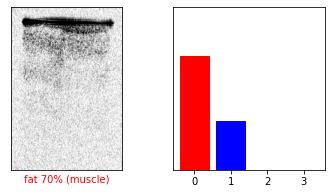

S8, idx=2279, pred=fat, actual=muscle


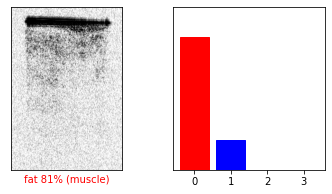

S8, idx=2334, pred=fat, actual=muscle


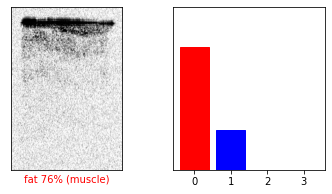

S8, idx=2343, pred=fat, actual=muscle


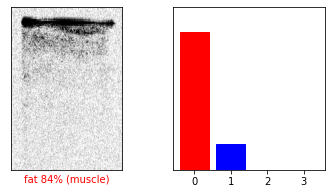

S8, idx=2382, pred=fat, actual=muscle


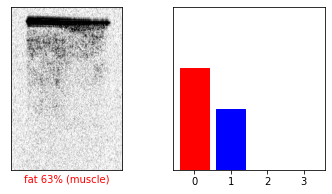

S8, idx=2430, pred=fat, actual=muscle


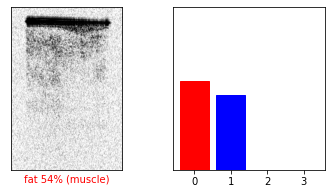

S8, idx=2495, pred=fat, actual=muscle


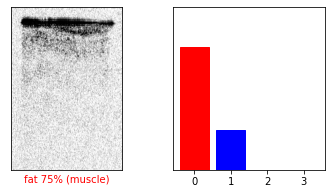

S8, idx=2542, pred=fat, actual=muscle


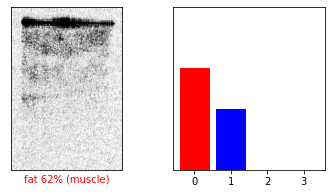

S8, idx=2561, pred=fat, actual=muscle


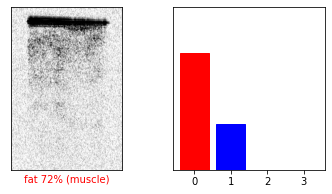

S8, idx=2572, pred=fat, actual=muscle


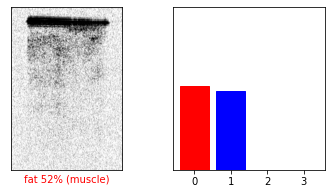

S8, idx=2596, pred=fat, actual=muscle


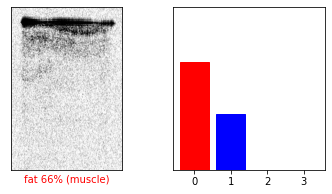

S8, idx=2618, pred=fat, actual=muscle


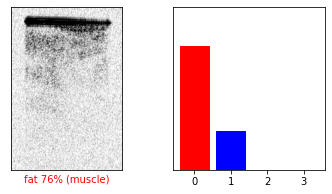

S8, idx=2703, pred=fat, actual=muscle


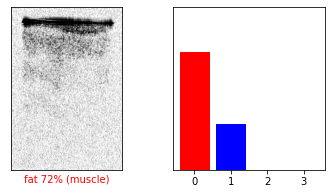

S8, idx=2715, pred=fat, actual=muscle


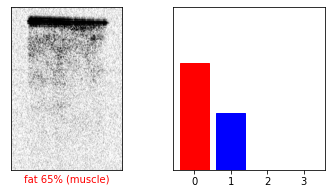

S8, idx=2910, pred=fat, actual=muscle


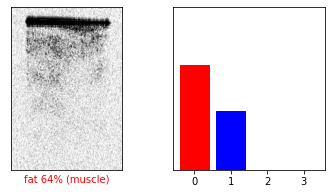

In [8]:
def plot_image(i, predictions_array, true_label, img):
    true_label, img = true_label[i], img[i]
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(img, cmap=plt.cm.binary)
    predicted_label = np.argmax(predictions_array)
    if predicted_label == true_label:
        color = 'blue'
    else:
        color = 'red'
    plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_label], 100*np.max(predictions_array), class_names[true_label]), color=color)

def plot_value_array(i, predictions_array, true_label, n_classes):
    true_label = true_label[i]
    plt.grid(False)
    plt.xticks(range(n_classes))
    plt.yticks([])
    thisplot = plt.bar(range(n_classes), predictions_array, color="#777777")
    plt.ylim([0, 1])
    predicted_label = np.argmax(predictions_array)
    thisplot[predicted_label].set_color('red')
    thisplot[true_label].set_color('blue')

misc_results_path = results_path+"misc/"
for S in vid_list:
    for i in range(len(y_test_dict[S])):
        if y_hardpreds_dict[S][i] != y_test_dict[S][i]:
            print('S%d, idx=%d, pred=%s, actual=%s'%(S, i, labels_map[y_hardpreds_dict[S][i]], labels_map[y_test_dict[S][i]]))
            n_classes=len(np.unique(y_test_dict[S]))
            plt.figure(figsize=(6,3))
            plt.subplot(1,2,1)
            img=X_test_dict[S][i]
            plot_image(i, y_preds_dict[S][i], y_test_dict[S], X_test_dict[S])
            plt.subplot(1,2,2)
            plot_value_array(i, y_preds_dict[S][i], y_test_dict[S], n_classes)
            plt.show()